In [ ]:
!git clone https://github.com/davidbau/ganseeing ganseeing 2>> install.log
!pip install ninja >> install.log
!pip install --force https://github.com/chengs/tqdm/archive/colab.zip  >> install.log


ERROR: spacy 2.2.4 has requirement tqdm<5.0.0,>=4.38.0, but you'll have tqdm 4.28.1 which is incompatible.


In [ ]:
%%writefile -a ganseeing/seeing/setting.py


def load_dataset(domain, split='train', full=False, download=True):
    if domain in g_datasets:
        return g_datasets[domain]
    dirname = os.path.join('datasets', 'lsun' + '_' + split if full else 'minilsun', domain)
    # dirname += '_' + split
    if download and not full and not os.path.exists('datasets/minilsun'):
        torchvision.datasets.utils.download_and_extract_archive(
                'http://gandissect.csail.mit.edu/datasets/minilsun.zip',
                'datasets',
                md5='4bf19f711555a5771220384db4c97999')
    print(dirname)
    return parallelfolder.ParallelImageFolders([dirname],
            transform=g_transform)

Appending to ganseeing/seeing/setting.py


In [ ]:
import sys
sys.path.append('/content/ganseeing')

import torch, copy
from seeing import nethook, setting, show, renormalize, zdataset, pbar
from seeing import encoder_net
from seeing import imgviz, segmenter
from torchvision import models
from torch.nn.functional import mse_loss, l1_loss
import numpy
import numpy as np
from tqdm import tqdm
torch.set_grad_enabled(False)
model = 'church'

In [ ]:
iv = imgviz.ImageVisualizer(256)
upp = segmenter.UnifiedParsingSegmenter()

In [ ]:
def divide_segmented(upp, loaded_image):
  orig_seg = upp.segment_batch(loaded_image.cuda())[0, 0:1]
  seg = orig_seg.cpu().numpy()

  flatseg = seg.reshape(seg.shape[0], seg.shape[1] * seg.shape[2])
  bc = numpy.bincount(flatseg.flatten())
  top = numpy.argsort(-bc)

  source_image = renormalize.as_tensor(loaded_image[0])

  all_images = []
  labels = []
  seglabels, _ = upp.get_label_and_category_names()
  for label in top:
    one_class = np.zeros((seg.shape[1] * seg.shape[2], 3))
    if label == 0:
        continue
    if bc[label] == 0:
        break
    bitmap = ((flatseg == label).sum(axis=0) > 0)
    one_class[bitmap] = source_image.permute(1,2,0).reshape(-1, 3)[bitmap]
    all_images.append(one_class.reshape(source_image.shape[1], source_image.shape[2], 3))
    labels.append(seglabels[label][0])
  return all_images, labels

Perceptual loss

In [ ]:
from collections import namedtuple
import torchvision.models.vgg as vgg

LossOutput = namedtuple(
    "LossOutput", ["relu1", "relu2", "relu3", "relu4", "relu5"])


class LossNetwork(torch.nn.Module):
    """Reference:
        https://discuss.pytorch.org/t/how-to-extract-features-of-an-image-from-a-trained-model/119/3
    """

    def __init__(self):
        super(LossNetwork, self).__init__()
        self.vgg_layers = vgg.vgg19(pretrained=True).features
        self.layer_name_mapping = {
            '3': "relu1",
            '8': "relu2",
            '17': "relu3",
            '26': "relu4",
            '35': "relu5",
        }

    def forward(self, x):
        output = {}
        for name, module in self.vgg_layers._modules.items():
            x = module(x)
            if name in self.layer_name_mapping:
                output[self.layer_name_mapping[name]] = x
        return LossOutput(**output)

In [ ]:
def gram_matrix(y):
    (b, ch, h, w) = y.size()
    features = y.view(b, ch, w * h)
    features_t = features.transpose(1, 2)
    gram = features.bmm(features_t) / (ch * h * w)
    return gram

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
with torch.no_grad():
    loss_network = LossNetwork()
    loss_network.to(device).double()
loss_network.eval()

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth


LossNetwork(
  (vgg_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1

In [ ]:
def get_pair_perceptual_metrics(img_1, img_2):
  with torch.no_grad():
    style_loss_features_1 = loss_network(torch.tensor(img_1).permute(2, 0, 1)[None,:,:,:].to(device))
    gram_style_1 = [gram_matrix(y) for y in style_loss_features_1]

    style_loss_features_2 = loss_network(torch.tensor(img_2).permute(2, 0, 1)[None,:,:,:].to(device))
    gram_style_2 = [gram_matrix(y) for y in style_loss_features_2]

  mse_loss = torch.nn.MSELoss()
  style_loss = 0

  for i in range(len(gram_style_1)):
    style_loss += mse_loss(gram_style_1[i], gram_style_2[i])
  content_loss = mse_loss(style_loss_features_1.relu3, style_loss_features_2.relu3)

  return content_loss, style_loss

Full train data

In [ ]:
!git clone https://github.com/fyu/lsun.git

!python lsun/download.py -c church_outdoor

!unzip church_outdoor_train_lmdb.zip

Cloning into 'lsun'...
remote: Enumerating objects: 72, done.
remote: Total 72 (delta 0), reused 0 (delta 0), pack-reused 72
Unpacking objects: 100% (72/72), done.
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 2335M  100 2335M    0     0  38.2M      0  0:01:01  0:01:01 --:--:-- 40.4M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 5817k  100 5817k    0     0  7327k      0 --:--:-- --:--:-- --:--:-- 7327k
Archive:  church_outdoor_train_lmdb.zip
   creating: church_outdoor_train_lmdb/
  inflating: church_outdoor_train_lmdb/lock.mdb  
  inflating: church_outdoor_train_lmdb/data.mdb  


In [ ]:
# lsun/data.py change lsun to download data

def export_images(db_path, out_dir, flat=False, limit=-1):
    print('Exporting', db_path, 'to', out_dir)
    env = lmdb.open(db_path, map_size=1099511627776,
                    max_readers=100, readonly=True)
    count = 0
    with env.begin(write=False) as txn:
        cursor = txn.cursor()
        for key, val in cursor:
            if not flat:
                image_out_dir = join(out_dir, '/'.join(key[:6].decode()))
            else:
                image_out_dir = out_dir
            if not exists(image_out_dir):
                os.makedirs(image_out_dir)
            # print('Current key:', key)
            image_out_path = join(image_out_dir, key.decode() + '.jpg')
            img = cv2.imdecode(
                numpy.fromstring(val, dtype=numpy.uint8), 1)
            cv2.imwrite(image_out_path, img)
            count += 1
            if count == limit:
                break
            if count % 1000 == 0:
                print('Finished', count, 'images')


In [ ]:
!python lsun/data.py export church_outdoor_train_lmdb/ --out_dir datasets/lsun_train/

Exporting church_outdoor_train_lmdb/ to datasets/lsun_train/
Finished 1000 images
Finished 2000 images
Finished 3000 images
Finished 4000 images
Finished 5000 images
Finished 6000 images
Finished 7000 images
Finished 8000 images
Finished 9000 images
Finished 10000 images
Finished 11000 images
Finished 12000 images
Finished 13000 images
Finished 14000 images
Finished 15000 images
Finished 16000 images
Finished 17000 images
Finished 18000 images
Finished 19000 images
Finished 20000 images
Finished 21000 images
Finished 22000 images
Finished 23000 images
Finished 24000 images
Finished 25000 images
Finished 26000 images
Finished 27000 images
Finished 28000 images
Finished 29000 images
Finished 30000 images
Finished 31000 images
Finished 32000 images
Finished 33000 images
Finished 34000 images
Finished 35000 images
Finished 36000 images
Finished 37000 images
Finished 38000 images
Finished 39000 images
Finished 40000 images
Finished 41000 images
Finished 42000 images
Finished 43000 images
Fi

In [ ]:
import sys
sys.path.append('/content/ganseeing')
from seeing import setting

model = 'church'
loaded_images = setting.load_dataset('', split='train', full=True)
print("Number of images : ", len(loaded_images.images))

Walking : 5990it [00:00, 59890.92it/s]

datasets/lsun_train/


Number of images :  126227


In [ ]:
def divide_segmented(upp, loaded_image):
  orig_seg = upp.segment_batch(loaded_image.cuda())[0, 0:1]
  seg = orig_seg.cpu().numpy()

  flatseg = seg.reshape(seg.shape[0], seg.shape[1] * seg.shape[2])
  bc = numpy.bincount(flatseg.flatten())
  top = numpy.argsort(-bc)

  source_image = renormalize.as_tensor(loaded_image[0])

  all_images = []
  labels = []
  seglabels, _ = upp.get_label_and_category_names()
  for label in top:
    one_class = np.zeros((seg.shape[1] * seg.shape[2], 3))
    if label == 0:
        continue
    if bc[label] == 0:
        break
    bitmap = ((flatseg == label).sum(axis=0) > 0)
    one_class[bitmap] = source_image.permute(1,2,0).reshape(-1, 3)[bitmap]
    all_images.append(one_class.reshape(source_image.shape[1], source_image.shape[2], 3))
    labels.append(seglabels[label][0])
  return all_images, labels

In [ ]:
from torch.utils.data import DataLoader

loader = DataLoader(loaded_images, batch_size=10)
upp = segmenter.UnifiedParsingSegmenter()

Подсчет сегментационных классов. 

In [ ]:

seglabels, _ = upp.get_label_and_category_names()
seg_clases_statistics = {}
with torch.no_grad():
    batch_index = 0
    for [batch] in tqdm(loader):
        seg_result = upp.segment_batch(batch.cuda())
        for i in range(len(batch)):
            result = seg_result[i,0].view(-1).bincount()
            records = result.nonzero()
            for label in records:
              if seglabels[label][0] in seg_clases_statistics:
                seg_clases_statistics[seglabels[label][0]] += 1
              else:
                seg_clases_statistics[seglabels[label][0]] = 1
        

100%|██████████| 12623/12623 [3:32:21<00:00,  1.09it/s]


In [ ]:
import pickle
with open("lsun_seg_stat" + '.pkl', 'wb') as f:
    pickle.dump(seg_clases_statistics, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
sorted_x = np.array(sorted(seg_clases_statistics.items(), key=lambda kv: kv[1], reverse=True))


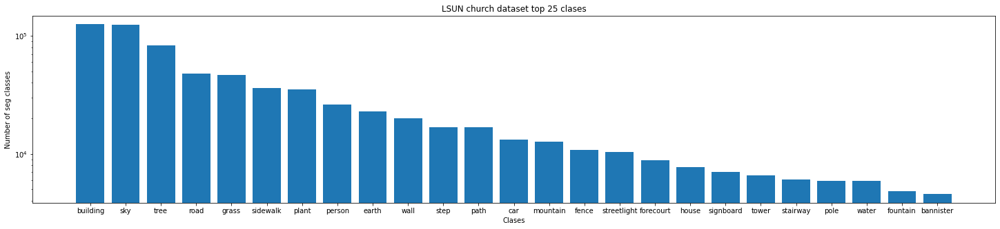

In [ ]:
import matplotlib.pyplot as plt
sorted_x
k = 25
plt.figure(figsize=(25,5))
plt.bar(sorted_x[:k, 0], sorted_x[:k, 1].astype(np.int32))
plt.title("LSUN church dataset top {} clases".format(k))
plt.ylabel("Number of seg classes")
plt.yscale("log")
plt.xlabel("Clases")
plt.show()

In [ ]:
def get_pair_perceptual_metrics(img_1, img_2):
  with torch.no_grad():
    style_loss_features_1 = loss_network(torch.tensor(img_1).permute(2, 0, 1)[None,:,:,:].to(device))
    gram_style_1 = [gram_matrix(y) for y in style_loss_features_1]

    style_loss_features_2 = loss_network(torch.tensor(img_2).permute(2, 0, 1)[None,:,:,:].to(device))
    gram_style_2 = [gram_matrix(y) for y in style_loss_features_2]

  mse_loss = torch.nn.MSELoss()
  style_loss = 0

  for i in range(len(gram_style_1)):
    style_loss += mse_loss(gram_style_1[i], gram_style_2[i])
  content_loss = mse_loss(style_loss_features_1.relu3, style_loss_features_2.relu3)

  return content_loss, style_loss

In [ ]:
def get_pair_perceptual_metric_new(img_1, img_2):
  with torch.no_grad():
    style_loss_features_1 = loss_network(img_1.double())
    gram_style_1 = [gram_matrix(y) for y in style_loss_features_1]

    style_loss_features_2 = loss_network(img_2.double())
    gram_style_2 = [gram_matrix(y) for y in style_loss_features_2]

  mse_loss = torch.nn.MSELoss(reduction='none')
  style_loss = 0

  content_loss_all = np.array([])
  style_loss_all = np.array([])

  for i in range(len(gram_style_1)):
    style_loss += ((gram_style_1[i].unsqueeze_(1) - gram_style_2[i].unsqueeze_(0)) ** 2 ).mean(dim=(2,3)).view(-1)

  content_loss = ((style_loss_features_1.relu3.unsqueeze_(1) - style_loss_features_2.relu3.unsqueeze_(0)) ** 2).mean(dim=(2,3,4)).view(-1)
  return content_loss.cpu().numpy(), style_loss.cpu().numpy()

In [ ]:
from google.colab import drive
import time
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Slow version


In [ ]:

seglabels, _ = upp.get_label_and_category_names()
seg_clases_statistics = {}
target_class_image = {}
k = 5
l = 0
perc_metrics_pairs = {l[0]:np.array([[1], [1]]) for l in seglabels}

with torch.no_grad():
    batch_index = 0
    for num_batch, [batch] in tqdm(enumerate(loader)):
      batch = batch.cuda()
      seg_result = upp.segment_batch(batch)
      
      labels = seg_result[:, 0].unique().cpu().numpy()
      for label in labels:
        one_class = torch.zeros_like(batch).to(device)
        bitmap = ((seg_result == label) > 0).to(device)
        one_class = batch * bitmap
        one_class = one_class[one_class.sum(dim=(1,2,3)) != 0]
        if label in target_class_image:
          if target_class_image[label].shape[0] < 10:
            target_class_image[label] = torch.cat((target_class_image[label], one_class))
          else:
            content_loss, style_loss = get_pair_perceptual_metric_new(one_class, target_class_image[label])
            perc_metrics_pairs[seglabels[label][0]] = np.hstack((perc_metrics_pairs[seglabels[label][0]], np.vstack((content_loss, style_loss))))
        else:
          target_class_image[label] = one_class
      if num_batch == 350:
        break

        

350it [5:48:04, 72.51s/it]

In [ ]:
import pickle
with open("/content/drive/My Drive/perc_metrics_pairs" + '.pkl', 'wb') as f:
    pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)

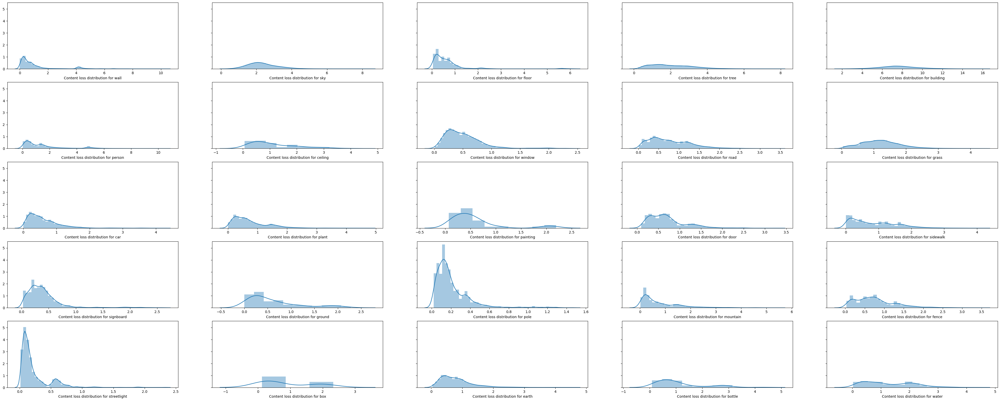

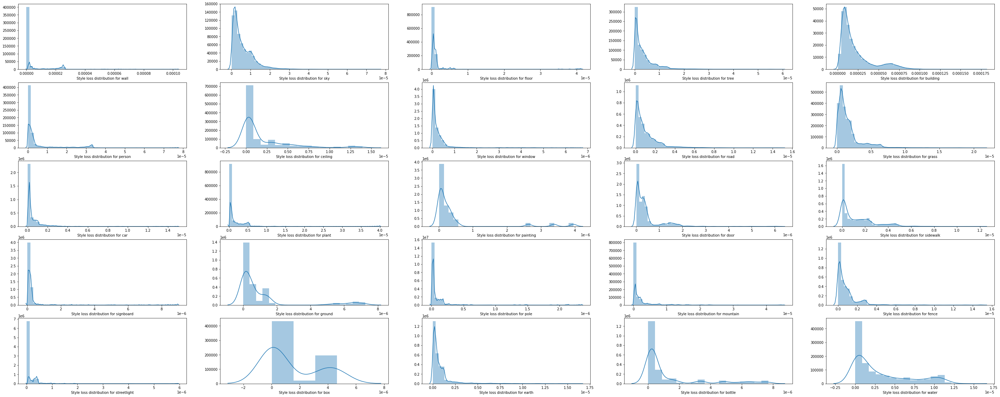

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(5, 5, figsize=(50, 20), sharey=True, dpi=100)
fig_s, axes_s = plt.subplots(5, 5, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    i += 1
  if i == 25:
    break

In [ ]:
from google.colab import drive

drive.mount('/content/drive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
%%writefile -a ganseeing/seeing/setting.py

def simple_load_dataset(dirname):
    print(dirname)
    return parallelfolder.ParallelImageFolders([dirname],
            transform=g_transform)

Appending to ganseeing/seeing/setting.py


Load StyleGan 2 images

In [ ]:
import sys
sys.path.append('/content/ganseeing')
from seeing import setting

model = 'church'
dirname = '/content/drive/My Drive/stylegan2-config-f-psi-1.0/'
loaded_images = setting.simple_load_dataset(dirname)
print("Number of images : ", len(loaded_images.images))

/content/drive/My Drive/stylegan2-config-f-psi-1.0/


Number of images :  100000


In [ ]:
from torch.utils.data import DataLoader

loader = DataLoader(loaded_images, batch_size=10)
upp = segmenter.UnifiedParsingSegmenter()

In [ ]:
seglabels, _ = upp.get_label_and_category_names()
seg_clases_statistics = {}
segmented_images = []
with torch.no_grad():
    batch_index = 0
    for num_batch, [batch] in tqdm(enumerate(loader)):
        seg_result = upp.segment_batch(batch.cuda())
        batch_masks = seg_result.cpu().numpy()
        for label in np.array(np.unique(batch_masks)):
          bitmap = ((batch_masks == label) > 0)
          for b in range(bitmap.shape[0]):
            m = bitmap[b, 0, :, :] + 0
            y, x = m.nonzero()
            if len(x) < 1:
              continue

            y_min, y_max = y.min(), y.max()
            x_min, x_max = x.min(), x.max()
            if y_max - y_min < 50 or x_max - x_min < 50 or y.shape / ((y_max - y_min) * (x_max - x_min)) < 0.2:
              seg_result[b, bitmap[b]] = 0
            
        segmented_images.append(seg_result.cpu().numpy())
        if num_batch > 200:
          break

201it [05:12,  1.57s/it]

In [ ]:
np.save("/content/drive/My Drive/seg_masks_stylegan2.npy", segmented_images)
np.save("/content/drive/My Drive/paths_stylegan2.npy", loaded_images.images)

np.save("/content/drive/My Drive/seg_masks_lsun.npy", segmented_images)
np.save("/content/drive/My Drive/paths_lsun.npy", loaded_images.images)

import pickle
with open('/content/drive/My Drive/'+ 'seglabels' + '.pkl', 'wb') as f:
    pickle.dump(seglabels, f, pickle.HIGHEST_PROTOCOL)

# with open("/content/drive/My Drive/perc_metrics_pairs_stylegan2_seg_class_10k" + '.pkl', 'wb') as f:
#     pickle.dump(sorted_x, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
import pickle
from PIL import Image


seg_mask_stylegan = np.load("/content/drive/My Drive/seg_masks_stylegan2.npy", allow_pickle=True)
paths_stylegan2 = np.load("/content/drive/My Drive/paths_stylegan2.npy")

# seg_mask_lsun = np.load("/content/drive/My Drive/seg_masks_lsun.npy")
# lsun_paths = np.load("/content/drive/My Drive/paths_lsun.npy")

with open('/content/drive/My Drive/'+ 'seglabels' + '.pkl', 'rb') as f:
     seg_label = pickle.load(f)

In [ ]:
import csv

!git clone https://github.com/CSAILVision/semantic-segmentation-pytorch.git

seg_label = {}
with open('semantic-segmentation-pytorch/data/object150_info.csv') as f:
    reader = csv.reader(f)
    next(reader)
    for row in reader:
        seg_label[int(row[0])] = row[5].split(";")[0]

Cloning into 'semantic-segmentation-pytorch'...
remote: Enumerating objects: 1039, done.
remote: Total 1039 (delta 0), reused 0 (delta 0), pack-reused 1039
Receiving objects: 100% (1039/1039), 4.00 MiB | 7.04 MiB/s, done.
Resolving deltas: 100% (634/634), done.


In [ ]:
import pickle
from PIL import Image
import glob

seg_mask_stylegan = np.load("/content/drive/My Drive/new_segmenter_masks_stylegan.npy")
paths_stylegan2 = np.array(glob.glob("/content/drive/My Drive/stylegan2-config-f-psi-1.0/000000/*.png", recursive=True))

# with open('/content/drive/My Drive/'+ 'seglabels' + '.pkl', 'rb') as f:
#      seg_label = pickle.load(f)

In [ ]:
import pickle
from PIL import Image
import glob

seg_mask_lsun = np.load("/content/drive/My Drive/new_segmenter_masks_lsun.npy", allow_pickle=True)

with open('/content/drive/My Drive/new_segmenter_lsun_paths' + '.pkl', 'rb') as f:
     lsun_paths = pickle.load(f)

lsun_paths = lsun_paths[:1000]

Старый сегментатор.

In [ ]:
def get_bounding_box(mask, label):
  bitmap = ((mask[0] == label) > 0)

  m = bitmap + 0
  y, x = m.nonzero()

  y_min, y_max = y.min(), y.max()
  x_min, x_max = x.min(), x.max()

  # if y_max - y_min > 50 and x_max - x_min > 50 and y.shape / ((y_max - y_min) * (x_max - x_min)) > 0.2:
  return y_min, y_max, x_min, x_max

In [ ]:
label = 1
perc_metrics_pairs = {l[0]:np.array([[1], [1]]) for l in seg_label}
all_labels = np.unique(seg_mask_stylegan[:, :, 0])

for k in tqdm(range(10)):
  for label in all_labels:
    if seg_mask_stylegan[np.sum(seg_mask_stylegan[:, :, 0] == label, axis=(2,3)) > 0].shape[0] < 10:
      continue
    m_1 = seg_mask_lsun[np.sum(seg_mask_lsun[:, :, 0] == label, axis=(2,3)) > 0][k]
    m_2 = seg_mask_lsun[np.sum(seg_mask_lsun[:, :, 0] == label, axis=(2,3)) > 0][k:]

    p_1 = lsun_paths[:2020][(np.sum(seg_mask_lsun[:, :, 0] == label, axis=(2,3)) > 0).reshape(-1)][k][0]
    p_2 = lsun_paths[:2020][(np.sum(seg_mask_lsun[:, :, 0] == label, axis=(2,3)) > 0).reshape(-1)][k:]
    
    im_1 = Image.open(p_1).resize((256, 256))
    ar_im_1 = np.array(im_1).transpose(2, 0, 1)
    y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(m_1, label)

    bitmap = ((m_1[0] == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = torch.from_numpy(one_class_1).cuda()

    for i in range(p_2.shape[0]):
      im_2 = Image.open(p_2[i][0]).resize((256, 256))
      ar_im_2 = np.array(im_2).transpose(2, 0, 1)
      y_min_2, y_max_2, x_min_2, x_max_2 = get_bounding_box(m_2[i], label)
      min_width = min(x_max_1 - x_min_1, x_max_2 - x_min_2)
      min_height = min(y_max_1 - y_min_1, y_max_2 - y_min_2)
      if min_width < 32 or min_height < 32:
        continue
      loc_one_class_1 = one_class_1[:, y_min_1:y_min_1 + min_height, x_min_1:x_min_1 + min_width]
      bitmap_2 = ((m_2[i] == label) > 0)
      one_class_2 = ar_im_2 * bitmap
      one_class_2 = one_class_2[:, y_min_2:y_min_2 + min_height, x_min_2:x_min_2 + min_width]
      one_class_2 = torch.from_numpy(one_class_2).cuda()

      content_loss, style_loss = get_pair_perceptual_metric_new(loc_one_class_1.unsqueeze(0), one_class_2.unsqueeze(0))
      perc_metrics_pairs[seg_label[label][0]] = np.hstack((perc_metrics_pairs[seg_label[label][0]], np.vstack((content_loss, style_loss))))


  0%|          | 0/10 [00:00<?, ?it/s]

Новый семгментатор.

In [ ]:
def get_bounding_box(mask, label):
  bitmap = ((mask == label) > 0)

  m = bitmap + 0
  y, x = m.nonzero()

  y_min, y_max = y.min(), y.max()
  x_min, x_max = x.min(), x.max()

  return y_min, y_max, x_min, x_max

In [ ]:
perc_metrics_pairs = {l:np.array([[1], [1]]) for _, l in seg_label.items()}
all_labels = np.unique(seg_mask_stylegan)

for k in tqdm(range(10)):
  for label in all_labels[1:]:
    label_mask = np.sum(seg_mask_stylegan == label, axis=(1, 2)) > 0
    if seg_mask_stylegan[label_mask].shape[0] < 10:
      continue
    m_1 = seg_mask_stylegan[label_mask][k]
    m_2 = seg_mask_stylegan[label_mask][k:]


    p_1 = paths_stylegan2[:2020][label_mask][k]
    p_2 = paths_stylegan2[:2020][label_mask][k:]
    
    im_1 = Image.open(p_1).resize((256, 256))
    ar_im_1 = np.array(im_1).transpose(2, 0, 1)
    y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(m_1, label)

    bitmap = ((m_1 == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = torch.from_numpy(one_class_1).cuda()

    for i in range(p_2.shape[0]):
      im_2 = Image.open(p_2[i]).resize((256, 256))
      ar_im_2 = np.array(im_2).transpose(2, 0, 1)
      y_min_2, y_max_2, x_min_2, x_max_2 = get_bounding_box(m_2[i], label)
      min_width = min(x_max_1 - x_min_1, x_max_2 - x_min_2)
      min_height = min(y_max_1 - y_min_1, y_max_2 - y_min_2)
      if min_width < 32 or min_height < 32:
        continue
      loc_one_class_1 = one_class_1[:, y_min_1:y_min_1 + min_height, x_min_1:x_min_1 + min_width]
      bitmap_2 = ((m_2[i] == label) > 0)
      one_class_2 = ar_im_2 * bitmap_2
      one_class_2 = one_class_2[:, y_min_2:y_min_2 + min_height, x_min_2:x_min_2 + min_width]
      one_class_2 = torch.from_numpy(one_class_2).cuda()

      content_loss, style_loss = get_pair_perceptual_metric_new(loc_one_class_1.unsqueeze(0), one_class_2.unsqueeze(0))
      perc_metrics_pairs[seg_label[label]] = np.hstack((perc_metrics_pairs[seg_label[label]], np.vstack((content_loss, style_loss))))


100%|██████████| 10/10 [2:44:22<00:00, 986.30s/it]


Для LSUN отдельная функция, тк там разные размеры изображений.

In [ ]:
perc_metrics_pairs_lsun = {l:np.array([[1], [1]]) for _, l in seg_label.items()}
all_labels = np.unique(np.concatenate([e.reshape(-1) for e in seg_mask_lsun]))

lsun_paths = np.array(lsun_paths)
for k in tqdm(range(10)):
  for label in all_labels[1:]:
    label_mask = [np.sum(elem == label) > 0 for elem in seg_mask_lsun]
    # if seg_mask_stylegan[label_mask].shape[0] < 10:
    #   continue
    masked_seg = [seg_mask_lsun[i] for i in range(len(seg_mask_lsun)) if label_mask[i]]
    if len(masked_seg) < 10:
      continue
    m_1 = masked_seg[k]
    m_2 = masked_seg[k:]


    p_1 = lsun_paths[:2020][np.array(label_mask)][k]
    p_2 = lsun_paths[:2020][np.array(label_mask)][k:]
    
    im_1 = Image.open(p_1)
    ar_im_1 = np.array(im_1).transpose(2, 0, 1)
    y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(m_1, label)

    bitmap = ((m_1 == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = torch.from_numpy(one_class_1).cuda()

    for i in range(p_2.shape[0]):
      im_2 = Image.open(p_2[i])
      ar_im_2 = np.array(im_2).transpose(2, 0, 1)
      y_min_2, y_max_2, x_min_2, x_max_2 = get_bounding_box(m_2[i], label)
      min_width = min(x_max_1 - x_min_1, x_max_2 - x_min_2)
      min_height = min(y_max_1 - y_min_1, y_max_2 - y_min_2)
      if min_width < 32 or min_height < 32:
        continue
      loc_one_class_1 = one_class_1[:, y_min_1:y_min_1 + min_height, x_min_1:x_min_1 + min_width]
      bitmap_2 = ((m_2[i] == label) > 0)
      one_class_2 = ar_im_2 * bitmap_2
      one_class_2 = one_class_2[:, y_min_2:y_min_2 + min_height, x_min_2:x_min_2 + min_width]
      one_class_2 = torch.from_numpy(one_class_2).cuda()
  
      content_loss, style_loss = get_pair_perceptual_metric_new(loc_one_class_1.unsqueeze(0), one_class_2.unsqueeze(0))
      perc_metrics_pairs_lsun[seg_label[label]] = np.hstack((perc_metrics_pairs_lsun[seg_label[label]], np.vstack((content_loss, style_loss))))


100%|██████████| 10/10 [2:33:16<00:00, 919.65s/it]


Получение статистик по матрицам Грамма и среднее по feature map


In [ ]:
def get_stat(img_1):
  with torch.no_grad():
    style_loss_features_1 = loss_network(img_1.double())
    gram_style_1 = [gram_matrix(y) for y in style_loss_features_1]
  
  mean_gramm = 0
  std_gramm = 0

  for i in range(len(gram_style_1)):
    mean_gramm += gram_style_1[i].mean()
    std_gramm += gram_style_1[i].std()

  mean_gramm /= len(gram_style_1)
  std_gramm /= len(gram_style_1)

  mean_relu3 = style_loss_features_1.relu3.mean()
  std_relu3 = style_loss_features_1.relu3.std()
  return (mean_relu3.cpu().item(), std_relu3.cpu().item()), (mean_gramm.cpu().item(), std_gramm.cpu().item())

In [ ]:
perc_metrics_pairs_lsun = {l:np.array([[1], [1]]) for _, l in seg_label.items()}
all_labels = np.unique(np.concatenate([e.reshape(-1) for e in seg_mask_lsun]))


for label in tqdm(all_labels[1:]):
  label_mask = np.sum(seg_mask_stylegan == label, axis=(1, 2)) > 0
  if seg_mask_stylegan[label_mask].shape[0] < 10:
    continue
  m_1 = seg_mask_stylegan[label_mask]
  p_1 = paths_stylegan2[:2020][label_mask]
  
  for i in range(p_1.shape[0]):
    im_1 = Image.open(p_1[i]).resize((256, 256))
    ar_im_1 = np.array(im_1).transpose(2, 0, 1)
    y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(m_1[i], label)

    if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
        continue
    bitmap = ((m_1[i] == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = torch.from_numpy(one_class_1).to(device)
    loc_one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]

    relu3, gram = get_stat(loc_one_class_1.unsqueeze(0))
    # print(relu3, gram)
    # break
    perc_metrics_pairs[seg_label[label + 1]] = np.hstack((perc_metrics_pairs[seg_label[label + 1]], np.vstack((relu3[0], gram[0]))))


  0%|          | 0/101 [00:04<?, ?it/s]


NameError: ignored

In [ ]:
perc_metrics_pairs_lsun = {l:np.array([[1], [1]]) for _, l in seg_label.items()}
all_labels = np.unique(seg_mask_stylegan)


for label in tqdm(all_labels[1:]):
    label_mask = [np.sum(elem == label) > 0 for elem in seg_mask_lsun]
    masked_seg = [seg_mask_lsun[i] for i in range(len(seg_mask_lsun)) if label_mask[i]]
    if len(masked_seg) < 10:
      continue
    m_1 = masked_seg
    p_1 = np.array(lsun_paths)[:2020][np.array(label_mask)]
    
    for i in range(p_1.shape[0]):
      im_1 = Image.open(p_1[i])
      ar_im_1 = np.array(im_1).transpose(2, 0, 1)
      y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(m_1[i], label)

      if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
          continue
      bitmap = ((m_1[i] == label) > 0)
      one_class_1 = ar_im_1 * bitmap
      one_class_1 = torch.from_numpy(one_class_1).to(device)
      loc_one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]

      relu3, gram = get_stat(loc_one_class_1.unsqueeze(0))
      perc_metrics_pairs_lsun[seg_label[label + 1]] = np.hstack((perc_metrics_pairs_lsun[seg_label[label + 1]], np.vstack((relu3[0], gram[0]))))


100%|██████████| 109/109 [1:03:47<00:00, 35.11s/it]


/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to c

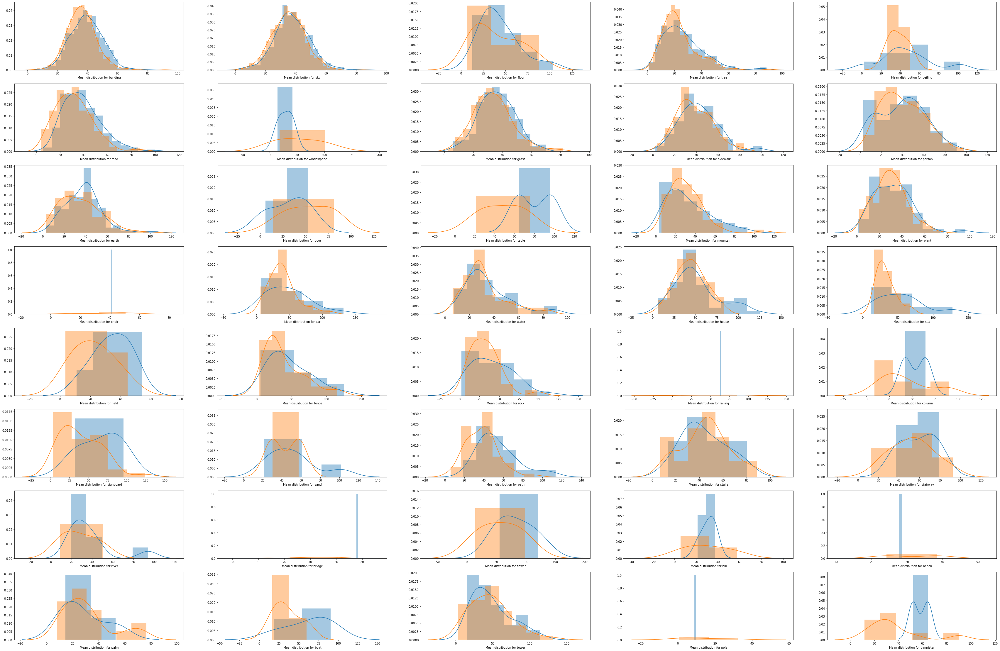

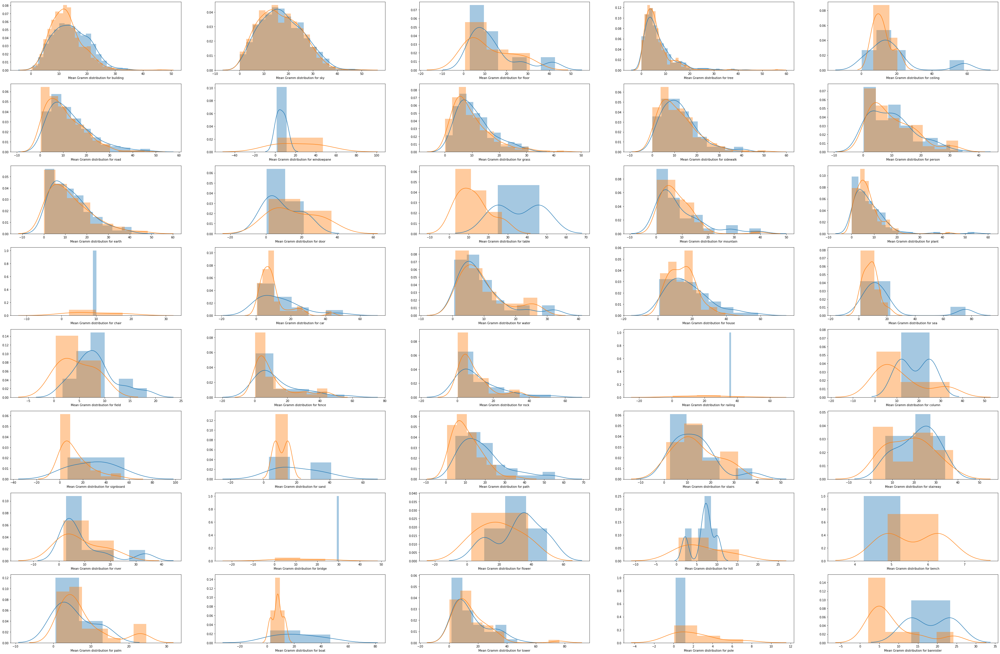

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(8, 5, figsize=(60, 40))
fig_2, axes_2 = plt.subplots(8, 5, figsize=(60, 40))

axes = axes.reshape(-1)
axes_2 = axes_2.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Mean distribution for {}".format(key))
    sns.distplot(perc_metrics_pairs_lsun[key][0,1:], ax=axes[i], axlabel="Mean distribution for {}".format(key))

    sns.distplot(metric[1,:], ax=axes_2[i], axlabel="Mean Gramm distribution for {}".format(key))
    sns.distplot(perc_metrics_pairs_lsun[key][1,1:], ax=axes_2[i], axlabel="Mean Gramm distribution for {}".format(key))
    i += 1
  if i == 40:
    break

In [ ]:
import pickle

with open("/content/drive/My Drive/mean_stylegan_segmenter" + '.pkl', 'wb') as f:
    pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)

with open("/content/drive/My Drive/mean_lsun_segmenter" + '.pkl', 'wb') as f:
    pickle.dump(perc_metrics_pairs_lsun, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
import pickle
with open("/content/drive/My Drive/mean_stylegan_segmenter" + '.pkl', 'rb') as f:
    perc_metrics_pairs = pickle.load(f)

with open("/content/drive/My Drive/mean_lsun_segmenter" + '.pkl', 'rb') as f:
    perc_metrics_pairs_lsun = pickle.load(f)

In [ ]:
from scipy.stats import entropy

kl_mean = {}
kl_gram = {}

for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 5 and perc_metrics_pairs_lsun[key][:, 1:].shape[1] > 4:
    metric_stylegan = metric[:, 1:]
    metric_lsun = perc_metrics_pairs_lsun[key][:, 1:]
    num_samples = min(metric_stylegan[0, :].shape[0], metric_lsun[0, :].shape[0])
    kl_mean[key] = entropy(np.random.choice(metric_stylegan[0, :], num_samples), qk=np.random.choice(metric_lsun[0, :], num_samples))
    num_samples = min(metric_stylegan[1, :].shape[0], metric_lsun[1, :].shape[0])
    kl_gram[key] = entropy(np.random.choice(metric_stylegan[1, :], num_samples), qk=np.random.choice(metric_lsun[1, :], num_samples))



In [ ]:
sorted_mean = np.array(sorted(kl_mean.items(), key=lambda kv: kv[1], reverse=True))
sorted_gram = np.array(sorted(kl_gram.items(), key=lambda kv: kv[1], reverse=True))


In [ ]:
sorted_mean

array([['wall', 'inf'],
       ['building', 'inf'],
       ['sky', 'inf'],
       ['floor', 'inf'],
       ['tree', 'inf'],
       ['ceiling', 'inf'],
       ['windowpane', 'inf'],
       ['sidewalk', 'inf'],
       ['person', 'inf'],
       ['table', 'inf'],
       ['mountain', 'inf'],
       ['chair', 'inf'],
       ['car', 'inf'],
       ['shelf', 'inf'],
       ['house', 'inf'],
       ['rug', 'inf'],
       ['seat', 'inf'],
       ['desk', 'inf'],
       ['column', 'inf'],
       ['grandstand', 'inf'],
       ['stairway', 'inf'],
       ['toilet', 'inf'],
       ['swivel', 'inf'],
       ['truck', 'inf'],
       ['ship', 'inf'],
       ['blanket', 'inf'],
       ['earth', '0.798358127561284'],
       ['cabinet', '0.29464809818274745'],
       ['screen', '0.27990873814247647'],
       ['book', '0.27747468223881894'],
       ['path', '0.1270179457139271']], dtype='<U19')

In [ ]:
sorted_gram

array([['wall', 'inf'],
       ['building', 'inf'],
       ['sky', 'inf'],
       ['floor', 'inf'],
       ['tree', 'inf'],
       ['ceiling', 'inf'],
       ['windowpane', 'inf'],
       ['sidewalk', 'inf'],
       ['person', 'inf'],
       ['table', 'inf'],
       ['mountain', 'inf'],
       ['car', 'inf'],
       ['shelf', 'inf'],
       ['house', 'inf'],
       ['rug', 'inf'],
       ['seat', 'inf'],
       ['desk', 'inf'],
       ['grandstand', 'inf'],
       ['path', 'inf'],
       ['screen', 'inf'],
       ['stairway', 'inf'],
       ['toilet', 'inf'],
       ['swivel', 'inf'],
       ['truck', 'inf'],
       ['ship', 'inf'],
       ['blanket', 'inf'],
       ['column', '1.9794829480676832'],
       ['earth', '1.6493858967562058'],
       ['cabinet', '1.3694593068762706'],
       ['book', '0.47726187869922065'],
       ['chair', '0.4322089777664565']], dtype='<U19')

In [ ]:
mean_threshold = []
for key, metric in perc_metrics_pairs_lsun.items():
  if metric.shape[1] > 5 and perc_metrics_pairs_lsun[key][:, 1:].shape[1] > 4:
    metric_stylegan = metric[:, 1:]
    for class_2, mean_gram in perc_metrics_pairs_lsun.items():
      if class_2 != key and mean_gram.shape[1] > 5:
        mean_gram = mean_gram[:, 1:]
        num_samples = min(metric_stylegan[1, :].shape[0], mean_gram[1, :].shape[0])
        kl = entropy(np.random.choice(metric_stylegan[1, :], num_samples), qk=np.random.choice(mean_gram[1, :], num_samples))
        mean_threshold.append(kl)


/usr/local/lib/python3.6/dist-packages/scipy/stats/_distn_infrastructure.py:2671: RuntimeWarning: invalid value encountered in true_divide
  qk = 1.0*qk / np.sum(qk, axis=axis, keepdims=True)


In [ ]:
treshold = np.mean(mean_threshold)

In [ ]:
clases_arr = np.array(sorted_gram)[:, 1]
selected_clases = np.array(sorted_gram)[clases_arr.astype(np.float32) < treshold]

In [ ]:
selected_clases

array([['plant', '0.5915818357947564'],
       ['stairs', '0.5872796066782102'],
       ['fence', '0.5634884673929299'],
       ['tree', '0.5616859881786315'],
       ['sidewalk', '0.5614148574743398'],
       ['ceiling', '0.5357896490258865'],
       ['grass', '0.5284143609952339'],
       ['rock', '0.5220635221658216'],
       ['house', '0.48189864233953744'],
       ['path', '0.4409346534309264'],
       ['signboard', '0.428000664082525'],
       ['sea', '0.3605487684872874'],
       ['sky', '0.32509939845436475'],
       ['river', '0.3002231756864414'],
       ['building', '0.22617237269304827'],
       ['fountain', '0.18308436579508908'],
       ['stairway', '0.10746106620685604']], dtype='<U19')

In [ ]:
inverse_seg_label = {value:key for key, value in seg_label.items()}

In [ ]:
seg_label

{1: 'wall',
 2: 'building',
 3: 'sky',
 4: 'floor',
 5: 'tree',
 6: 'ceiling',
 7: 'road',
 8: 'bed',
 9: 'windowpane',
 10: 'grass',
 11: 'cabinet',
 12: 'sidewalk',
 13: 'person',
 14: 'earth',
 15: 'door',
 16: 'table',
 17: 'mountain',
 18: 'plant',
 19: 'curtain',
 20: 'chair',
 21: 'car',
 22: 'water',
 23: 'painting',
 24: 'sofa',
 25: 'shelf',
 26: 'house',
 27: 'sea',
 28: 'mirror',
 29: 'rug',
 30: 'field',
 31: 'armchair',
 32: 'seat',
 33: 'fence',
 34: 'desk',
 35: 'rock',
 36: 'wardrobe',
 37: 'lamp',
 38: 'bathtub',
 39: 'railing',
 40: 'cushion',
 41: 'base',
 42: 'box',
 43: 'column',
 44: 'signboard',
 45: 'chest',
 46: 'counter',
 47: 'sand',
 48: 'sink',
 49: 'skyscraper',
 50: 'fireplace',
 51: 'refrigerator',
 52: 'grandstand',
 53: 'path',
 54: 'stairs',
 55: 'runway',
 56: 'case',
 57: 'pool',
 58: 'pillow',
 59: 'screen',
 60: 'stairway',
 61: 'river',
 62: 'bridge',
 63: 'bookcase',
 64: 'blind',
 65: 'coffee',
 66: 'toilet',
 67: 'flower',
 68: 'book',
 69: '

In [ ]:
inverse_seg_label["stairs"]

54

In [ ]:
# label = 12 #хороший пример работы метрики на классе person
# label = 17  тоже норм plant 
# label = 21 water тоже норм
# label = 16 mountain тоже хороший пример
# label = 20 #car тоже подходит
# label = 25 house не всегда хорошая сегментация поэтому
# label = 72 #palm детектируется полная фигня в stylegan и норм в lsun
# label = 104 fountain фонтанов в stylegan нет
# label = 53 stairs
# label = 76
# label = 12
label = 53
label_mask_stylegan = np.sum(seg_mask_stylegan == label, axis=(1, 2)) > 0

label_mask = [np.sum(elem == label) > 0 for elem in seg_mask_lsun]
masked_seg = [seg_mask_lsun[i] for i in range(len(seg_mask_lsun)) if label_mask[i]]

m_1 = seg_mask_stylegan[label_mask_stylegan]

m_2 = masked_seg

p_1 = paths_stylegan2[:2020][label_mask_stylegan]

p_2 = np.array(lsun_paths)[:2020][np.array(label_mask)]


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

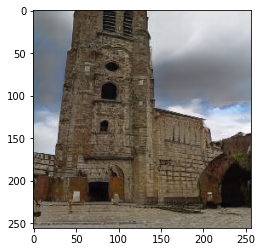

223 255 0 145


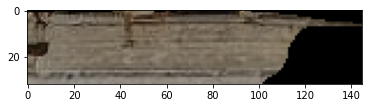

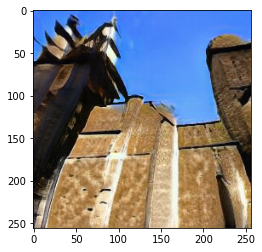

187 251 93 244


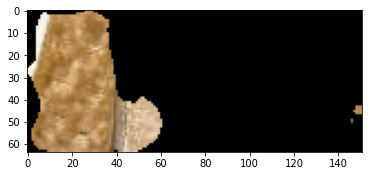

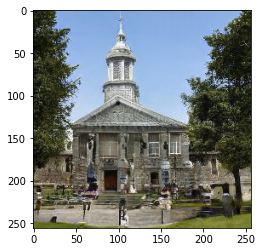

212 247 59 150


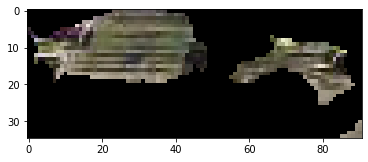

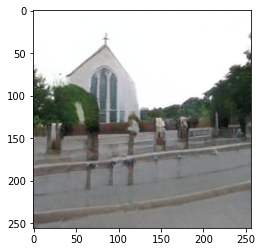

144 234 2 140


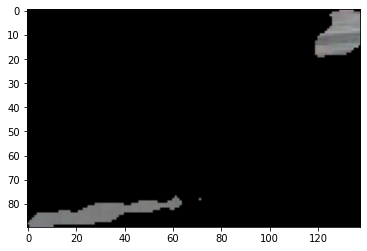

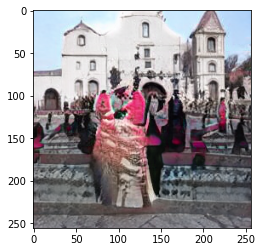

119 255 0 255


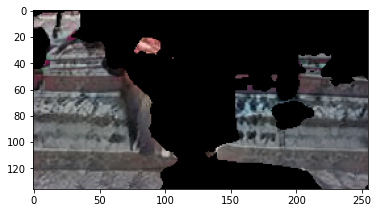

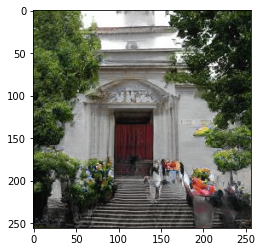

194 255 53 221


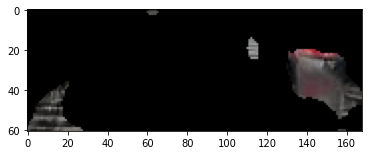

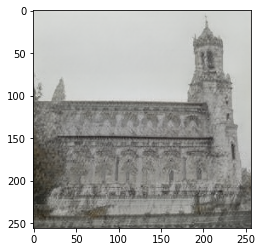

220 255 83 172


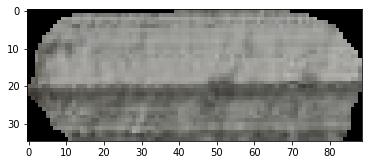

In [ ]:
for i in range(50):
  path = p_1[i]
  mask = m_1[i]
  im_1 = Image.open(path).resize((256, 256))

  ar_im_1 = np.array(im_1).transpose(2, 0, 1)
  y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(mask, label)
  if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
    continue
  if x_max_1 > x_min_1 and y_max_1 > y_min_1:
    plt.imshow(im_1)
    plt.show()
    print(y_min_1, y_max_1, x_min_1, x_max_1)
    bitmap = ((mask == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]
    plt.imshow(one_class_1.transpose(1, 2, 0))
    plt.show()
  

201 255 237 340


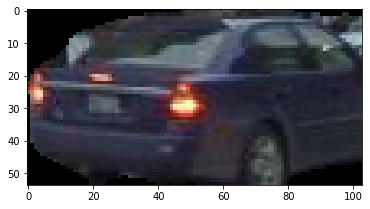

207 255 0 258


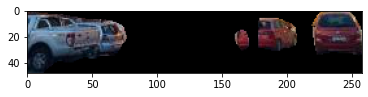

198 255 0 306


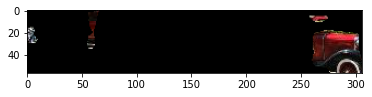

223 255 268 384


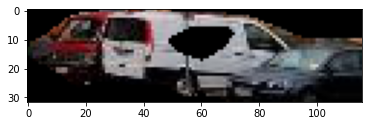

171 204 150 344


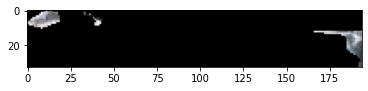

221 255 0 383


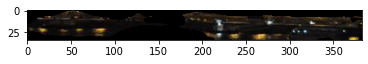

219 253 0 65


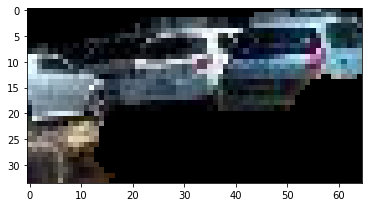

344 376 0 183


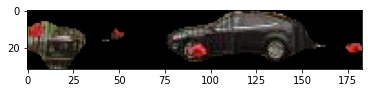

213 255 0 146


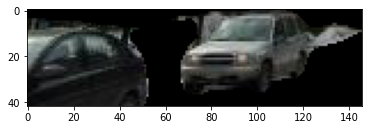

183 216 13 252


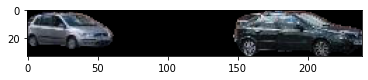

182 226 192 260


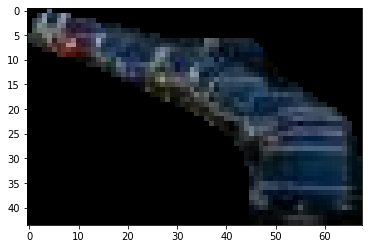

In [ ]:
for i in range(50):
  path = p_2[i]
  mask = m_2[i]
  im_1 = Image.open(path)
  # plt.imshow(im_1)
  # plt.show()
  ar_im_1 = np.array(im_1).transpose(2, 0, 1)
  y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(mask, label)
  if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
    continue
  if x_max_1 > x_min_1 and y_max_1 > y_min_1:
    print(y_min_1, y_max_1, x_min_1, x_max_1)
    bitmap = ((mask == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]
    plt.imshow(one_class_1.transpose(1, 2, 0))
    plt.show()
  

In [ ]:
import pickle

# with open("/content/drive/My Drive/perceptual_new_one_vs_stylegan" + '.pkl', 'wb') as f:
#     pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)

# with open("/content/drive/My Drive/perceptual_new_one_vs_lsun" + '.pkl', 'wb') as f:
#     pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)

# with open("/content/drive/My Drive/perceptual_new_one_vs_stylegan_new_segmenter" + '.pkl', 'wb') as f:
#     pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)


with open("/content/drive/My Drive/perceptual_new_one_vs_lsun_new_segmenter" + '.pkl', 'wb') as f:
    pickle.dump(perc_metrics_pairs_lsun, f, pickle.HIGHEST_PROTOCOL)


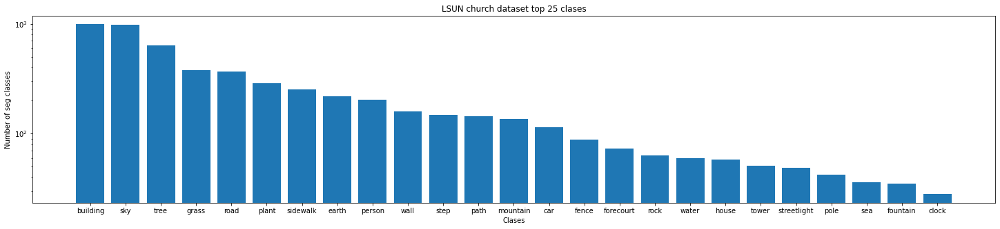

In [ ]:
import matplotlib.pyplot as plt
sorted_x
k = 25
plt.figure(figsize=(25,5))
plt.bar(sorted_x[:k, 0], sorted_x[:k, 1].astype(np.int32))
plt.title("LSUN church dataset top {} clases".format(k))
plt.ylabel("Number of seg classes")
plt.yscale("log")
plt.xlabel("Clases")
plt.show()

In [ ]:
def get_pair_perceptual_metric_new(img_1, img_2):
  with torch.no_grad():
    style_loss_features_1 = loss_network(img_1.double())
    gram_style_1 = [gram_matrix(y) for y in style_loss_features_1]

    style_loss_features_2 = loss_network(img_2.double())
    gram_style_2 = [gram_matrix(y) for y in style_loss_features_2]

  mse_loss = torch.nn.MSELoss(reduction='none')
  style_loss = 0
  
  content_loss_all = np.array([])
  style_loss_all = np.array([])

  for i in range(len(gram_style_1)):
    style_loss += ((gram_style_1[i].unsqueeze_(1) - gram_style_2[i].unsqueeze_(0)) ** 2 ).mean(dim=(2,3)).view(-1)

  content_loss = ((style_loss_features_1.relu3.unsqueeze_(1) - style_loss_features_2.relu3.unsqueeze_(0)) ** 2).mean(dim=(2,3,4)).view(-1)
  return content_loss.cpu().numpy(), style_loss.cpu().numpy()

In [ ]:

seglabels, _ = upp.get_label_and_category_names()
seg_clases_statistics = {}
target_class_image = {}
k = 5
l = 0
perc_metrics_pairs = {l[0]:np.array([[1], [1]]) for l in seglabels}

with torch.no_grad():
    batch_index = 0
    for num_batch, [batch] in tqdm(enumerate(loader)):
      batch = batch.cuda()
      seg_result = upp.segment_batch(batch)
      
      labels = seg_result[:, 0].unique().cpu().numpy()
      for label in labels:
        one_class = torch.zeros_like(batch).to(device)
        bitmap = ((seg_result == label) > 0).to(device)
        one_class = batch * bitmap
        one_class = one_class[one_class.sum(dim=(1,2,3)) != 0]
        if label in target_class_image:
          if target_class_image[label].shape[0] < 10:
            target_class_image[label] = torch.cat((target_class_image[label], one_class))
          else:
            content_loss, style_loss = get_pair_perceptual_metric_new(one_class, target_class_image[label])
            perc_metrics_pairs[seglabels[label][0]] = np.hstack((perc_metrics_pairs[seglabels[label][0]], np.vstack((content_loss, style_loss))))
        else:
          target_class_image[label] = one_class
      if num_batch == 350:
        break

        

In [ ]:
import pickle
with open("/content/drive/My Drive/perc_metrics_pairs_stylegan2" + '.pkl', 'wb') as f:
    pickle.dump(perc_metrics_pairs, f, pickle.HIGHEST_PROTOCOL)

только stylegan

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


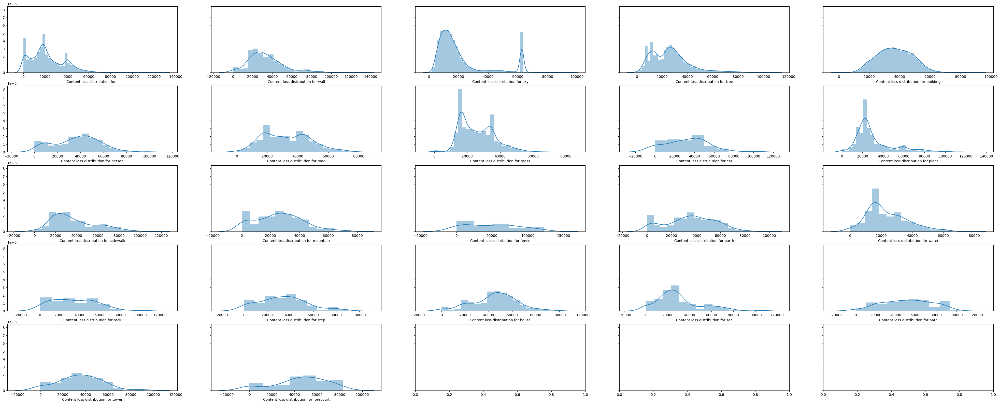

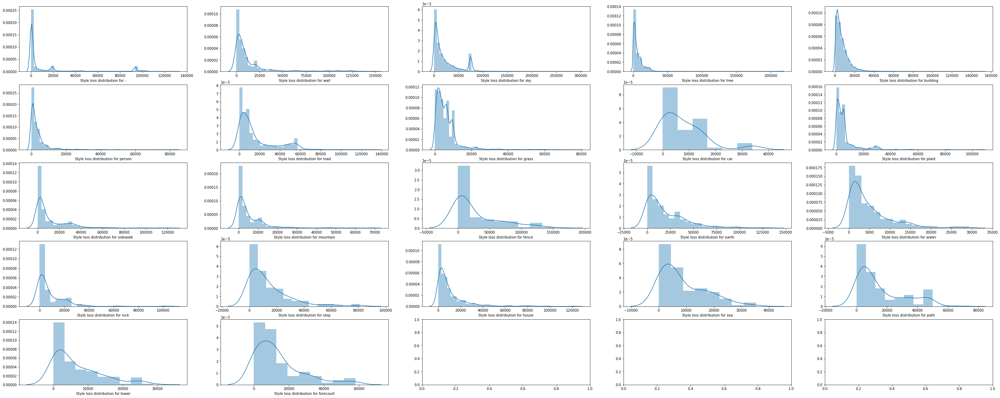

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(5, 5, figsize=(50, 20), sharey=True, dpi=100)
fig_s, axes_s = plt.subplots(5, 5, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    i += 1
  if i == 25:
    break

неправильно stylegan vs lsun

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


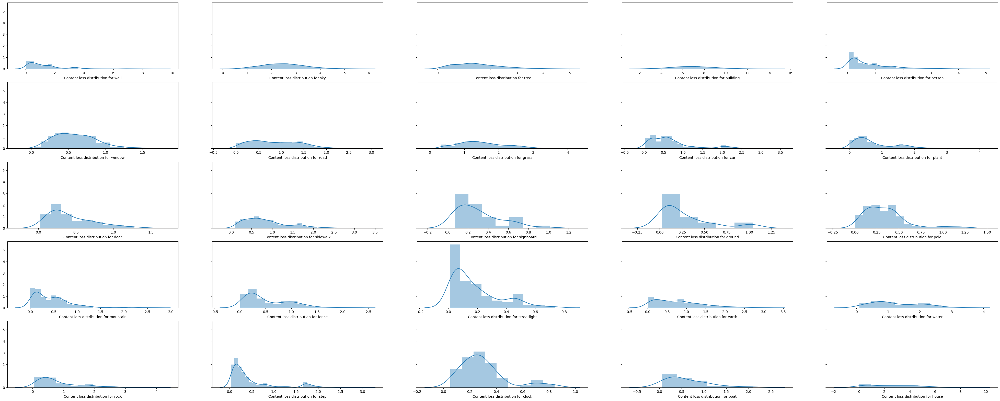

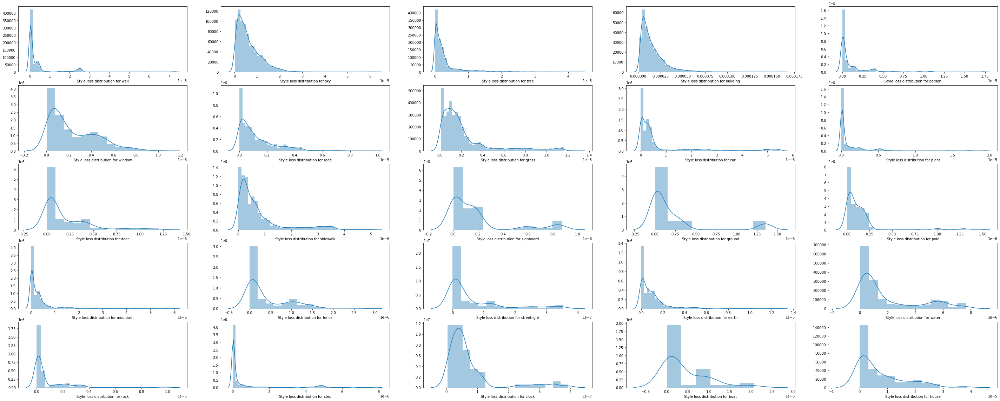

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(5, 5, figsize=(50, 20), sharey=True, dpi=100)
fig_s, axes_s = plt.subplots(5, 5, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    i += 1
  if i == 25:
    break

In [ ]:
import pickle
with open("/content/drive/My Drive/perceptual_new_one_vs_stylegan_new_segmenter" + '.pkl', 'rb') as f:
    perc_metrics_pairs_lsun = pickle.load(f)

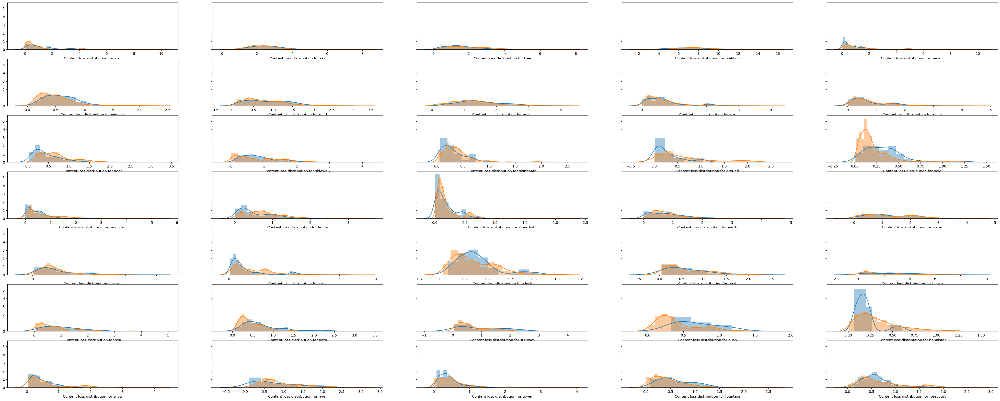

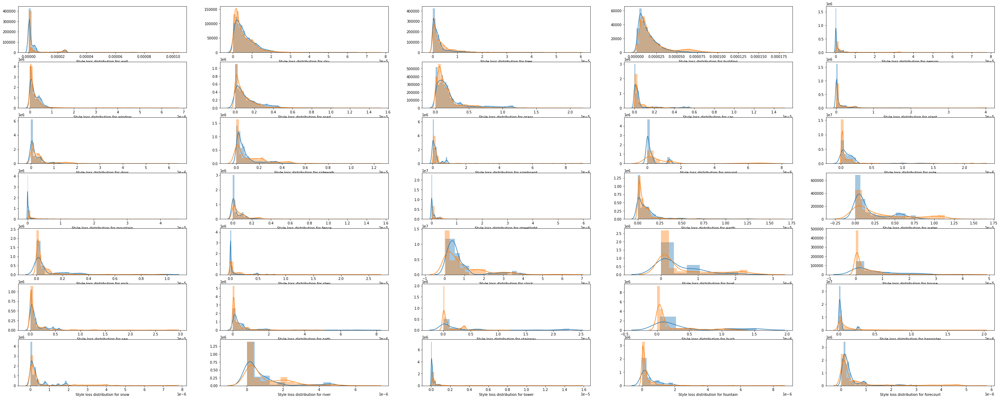

In [ ]:
k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(7, 5, figsize=(50, 20), sharey=True, dpi=100)
fig_s, axes_s = plt.subplots(7, 5, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    sns.distplot(perc_metrics_pairs_lsun[key][0,1:], ax=axes[i])
    sns.distplot(perc_metrics_pairs_lsun[key][1,1:], ax=axes_s[i])
    i += 1
  if i == 35:
    break

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


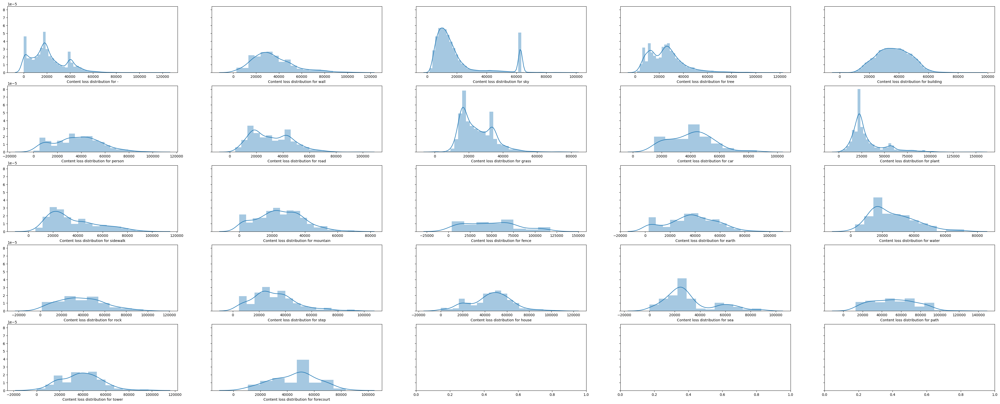

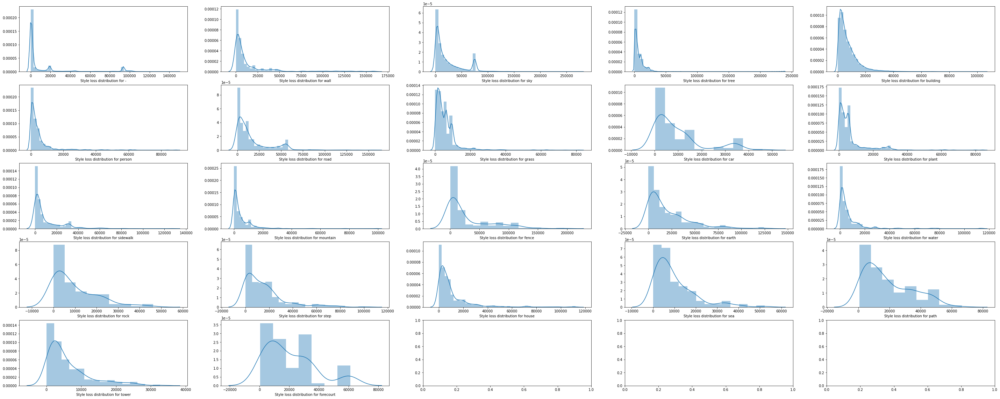

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(5, 5, figsize=(50, 20), sharey=True, dpi=100)
fig_s, axes_s = plt.subplots(5, 5, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    i += 1
  if i == 25:
    break

Старый сегментатор результат.

In [ ]:
import pickle
with open("/content/drive/My Drive/perc_metrics_pairs_stylegan2" + '.pkl', 'rb') as f:
    perc_metrics_pairs = pickle.load(f)

with open("/content/drive/My Drive/perc_metrics_pairs" + '.pkl', 'rb') as f:
    perc_metrics_pairs_lsun = pickle.load(f)

IndexError: ignored

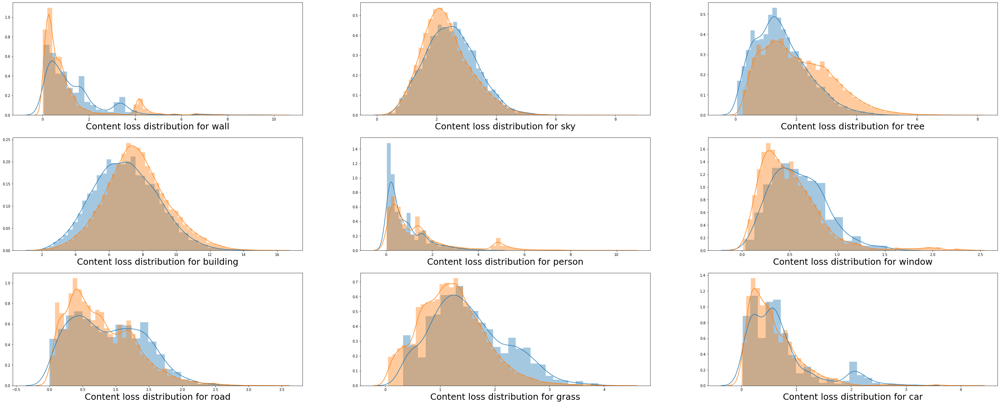

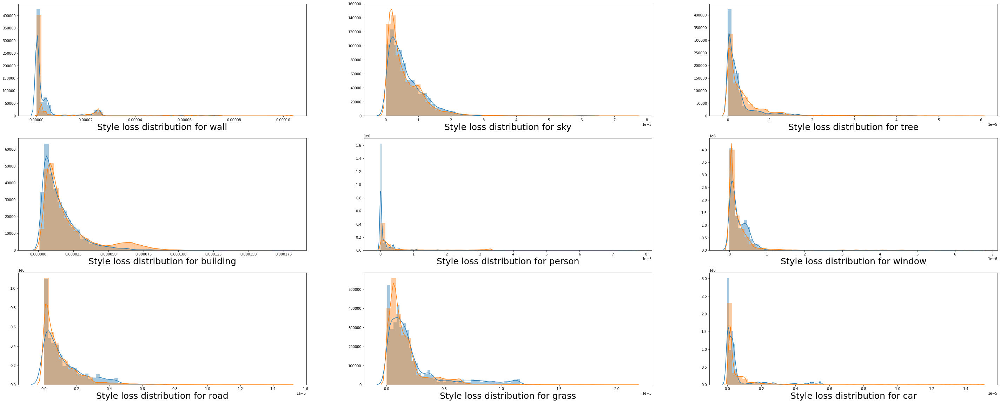

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1
  
fig, axes = plt.subplots(3, 3, figsize=(50, 20))
fig_s, axes_s = plt.subplots(3, 3, figsize=(50, 20))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if key not in perc_metrics_pairs_lsun:
    continue
  if metric.shape[1] > 1:
    metric = metric[:, 1:]
    axes[i].xaxis.label.set_size(25)
    axes_s[i].xaxis.label.set_size(25)
    sns.distplot(metric[0,:], ax=axes[i], axlabel="Content loss distribution for {}".format(key))
    sns.distplot(metric[1,:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(key))
    sns.distplot(perc_metrics_pairs_lsun[key][0,1:], ax=axes[i])
    sns.distplot(perc_metrics_pairs_lsun[key][1,1:], ax=axes_s[i])
    i += 1
  if i == 10:
    break

Новый сегментатор результат.

In [ ]:
import pickle
with open("/content/drive/My Drive/perceptual_new_one_vs_stylegan_new_segmenter" + '.pkl', 'rb') as f:
    perc_metrics_pairs = pickle.load(f)

with open("/content/drive/My Drive/perceptual_new_one_vs_lsun_new_segmenter" + '.pkl', 'rb') as f:
    perc_metrics_pairs_lsun = pickle.load(f)

In [ ]:
num_classes = 0
for key, metric in perc_metrics_pairs.items():
  if key in selected_clases:
    num_classes += 1

In [ ]:
selected_clases = a[a.columns[1]].values

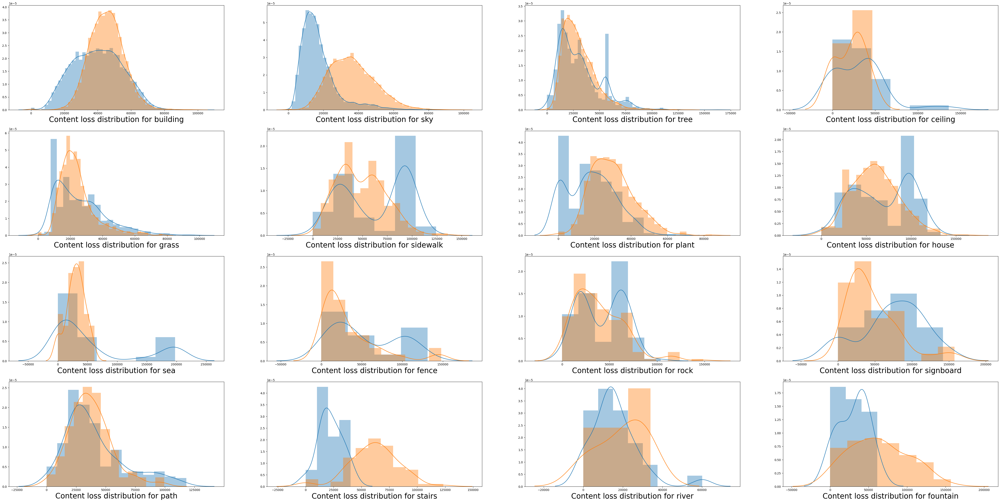

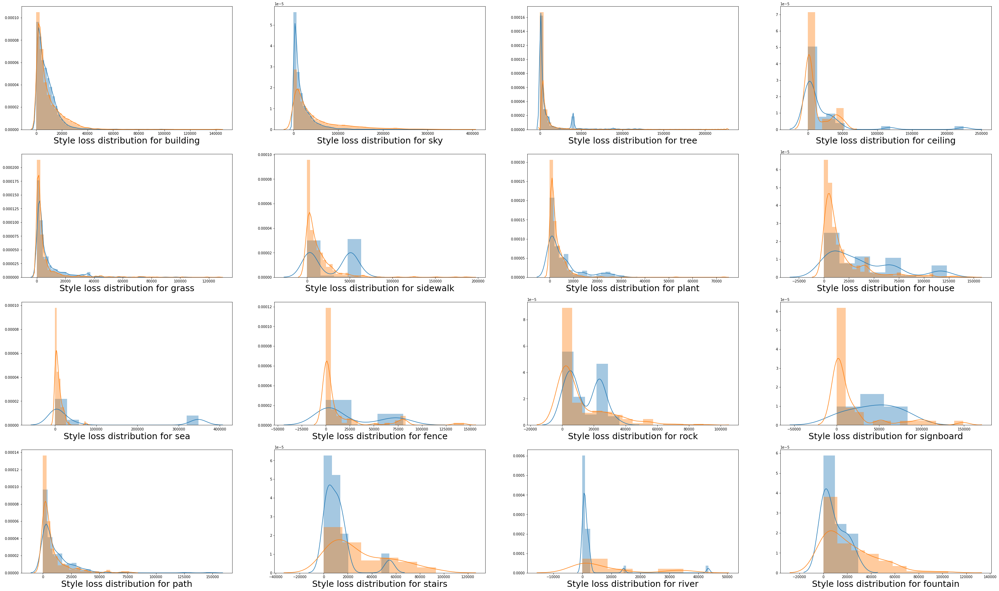

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

k = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    k += 1

inverse_seg_label = {value:key for key, value in seg_label.items()}

fig, axes = plt.subplots(4, 4, figsize=(60, 30), dpi=100)
fig_s, axes_s = plt.subplots(4, 4, figsize=(50, 30))

axes = axes.reshape(-1)
axes_s = axes_s.reshape(-1)
i = 0
for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    actual_class = seg_label[inverse_seg_label[key] + 1]
    if actual_class in selected_clases:
      axes[i].xaxis.label.set_size(25)
      axes_s[i].xaxis.label.set_size(25)
      sns.distplot(metric[0,1:], ax=axes[i], axlabel="Content loss distribution for {}".format(actual_class))
      sns.distplot(metric[1,1:], ax=axes_s[i], axlabel="Style loss distribution for {}".format(actual_class))
      sns.distplot(perc_metrics_pairs_lsun[key][0,1:], ax=axes[i])
      sns.distplot(perc_metrics_pairs_lsun[key][1,1:], ax=axes_s[i])
      i += 1

In [ ]:
from scipy.stats import entropy

kl_content = {}
kl_style = {}
EPS = 10e-32

for key, metric in perc_metrics_pairs.items():
  if metric.shape[1] > 1:
    actual_class = seg_label[inverse_seg_label[key] + 1]
    if actual_class in selected_clases:
      metric_stylegan = metric[:, 1:]
      metric_lsun = perc_metrics_pairs_lsun[key][:, 1:]
      num_samples = min(metric_stylegan[0, :].shape[0], metric_lsun[0, :].shape[0])
      metric_stylegan += EPS
      metric_lsun += EPS
      kl_content[actual_class] = entropy(np.random.choice(metric_stylegan[0, :], num_samples), qk=np.random.choice(metric_lsun[0, :], num_samples))
      num_samples = min(metric_stylegan[1, :].shape[0], metric_lsun[1, :].shape[0])
      kl_style[actual_class] = entropy(np.random.choice(metric_stylegan[1, :], num_samples), qk=np.random.choice(metric_lsun[1, :], num_samples))


In [ ]:
sorted_content = np.array(sorted(kl_content.items(), key=lambda kv: kv[1], reverse=True))
sorted_style = np.array(sorted(kl_style.items(), key=lambda kv: kv[1], reverse=True))


In [ ]:
sorted_content

array([['ceiling', '9.646579549018346'],
       ['fountain', '7.066406478731616'],
       ['river', '3.8260821511207643'],
       ['stairs', '3.2353329022170407'],
       ['fence', '2.4195489554605283'],
       ['rock', '1.251026554302149'],
       ['path', '0.7430190110357424'],
       ['signboard', '0.6630611436314687'],
       ['sea', '0.6005018051913406'],
       ['house', '0.5603799067916388'],
       ['plant', '0.5399890275111208'],
       ['sidewalk', '0.4149641143052957'],
       ['tree', '0.3664821059566169'],
       ['grass', '0.32998754811941794'],
       ['sky', '0.29080319412992983'],
       ['building', '0.12016137514107478']], dtype='<U19')

In [ ]:
sorted_style

array([['ceiling', '13.569185935506477'],
       ['sea', '3.343061665129734'],
       ['fence', '3.153034314008341'],
       ['river', '2.9389162785552254'],
       ['fountain', '2.866425957156856'],
       ['rock', '2.5886891038272886'],
       ['tree', '2.2186629426052513'],
       ['signboard', '2.0363109956425953'],
       ['stairs', '1.973767287000029'],
       ['grass', '1.9054446352182515'],
       ['sidewalk', '1.5330914569449705'],
       ['path', '1.5066194008467166'],
       ['sky', '1.4451232451827383'],
       ['plant', '1.3650100931654578'],
       ['house', '1.116229603932271'],
       ['building', '0.9530420180262819']], dtype='<U18')

In [ ]:
import pandas as pd
pd.DataFrame(data=np.hstack((sorted_content, sorted_style))) 

,0,1,2,3
0,ceiling,9.646579549018346,ceiling,13.569185935506477
1,fountain,7.066406478731616,sea,3.343061665129734
2,river,3.8260821511207643,fence,3.153034314008341
3,stairs,3.2353329022170407,river,2.9389162785552254
4,fence,2.4195489554605283,fountain,2.866425957156856
5,rock,1.251026554302149,rock,2.5886891038272886
6,path,0.7430190110357424,tree,2.2186629426052513
7,signboard,0.6630611436314687,signboard,2.0363109956425953
8,sea,0.6005018051913406,stairs,1.973767287000029
9,house,0.5603799067916388,grass,1.9054446352182515


In [ ]:
final_kl = pd.DataFrame(data=np.hstack((sorted_content, sorted_style))) 
final_kl.to_csv("/content/drive/My Drive/final_kl.csv")

In [ ]:
import pandas as pd
a = pd.read_csv("/content/drive/My Drive/final_kl.csv")

In [ ]:
import glob

paths_stylegan2 = np.array(glob.glob("/content/drive/My Drive/stylegan2-config-f-psi-1.0/000000/*.png", recursive=True))

with open('/content/drive/My Drive/new_segmenter_lsun_paths' + '.pkl', 'rb') as f:
     lsun_paths = pickle.load(f)

lsun_paths = lsun_paths[:1000]

In [ ]:
seg_label[inverse_seg_label["palm"] + 1]

In [ ]:
inverse_seg_label["plant"]

18

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
# label = 12 хороший пример работы метрики на классе person
# label = 17  тоже норм plant 
# label = 21 water тоже норм
# label = 16 mountain тоже хороший пример
# label = 20 car тоже подходит
# label = 25 house не всегда хорошая сегментация поэтому
# label = 72 #palm детектируется полная фигня в stylegan и норм в lsun
# label = 104 fountain фонтанов в stylegan нет
# label = 53 stairs
# label = 76
label = 2
label_mask_stylegan = np.sum(seg_mask_stylegan == label, axis=(1, 2)) > 0

label_mask = [np.sum(elem == label) > 0 for elem in seg_mask_lsun]
masked_seg = [seg_mask_lsun[i] for i in range(len(seg_mask_lsun)) if label_mask[i]]

m_1 = seg_mask_stylegan[label_mask_stylegan]

m_2 = masked_seg

p_1 = paths_stylegan2[:2020][label_mask_stylegan]

p_2 = np.array(lsun_paths)[:2020][np.array(label_mask)]


In [ ]:
len(p_2)

989

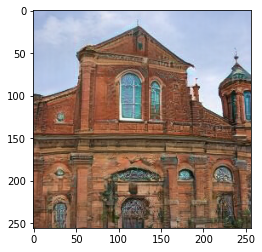

0 121 0 255


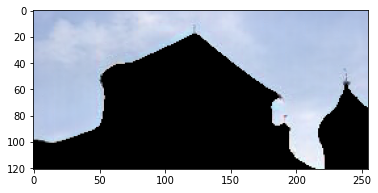

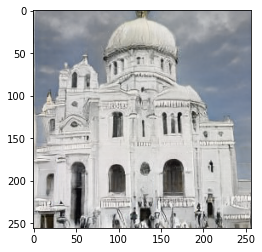

0 198 0 255


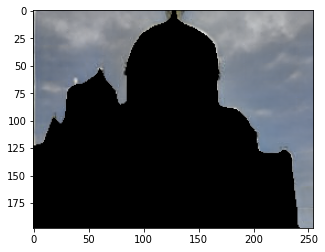

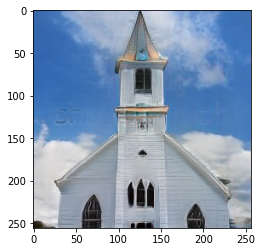

0 255 0 255


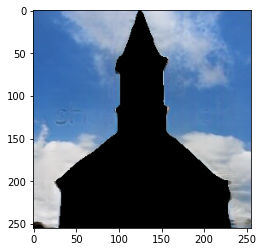

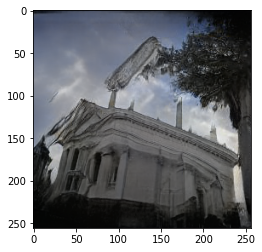

0 158 0 238


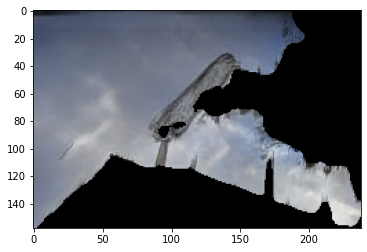

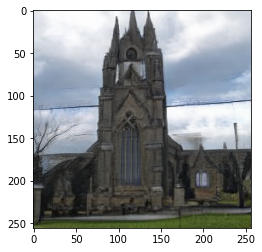

0 169 0 255


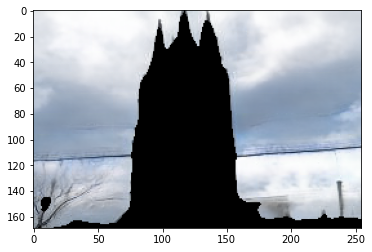

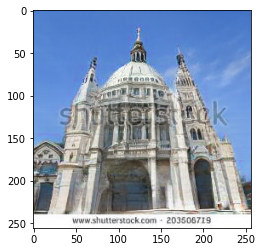

0 200 0 255


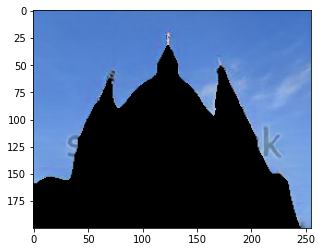

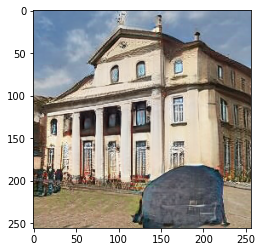

0 102 0 255


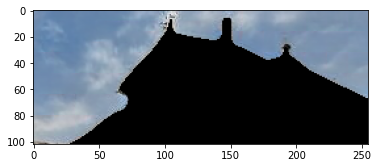

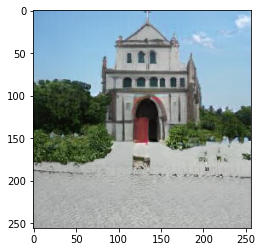

0 117 0 255


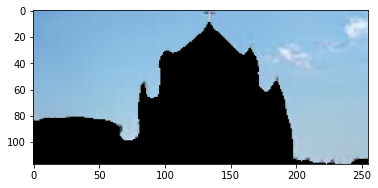

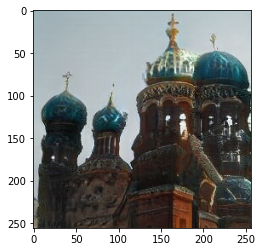

0 215 0 255


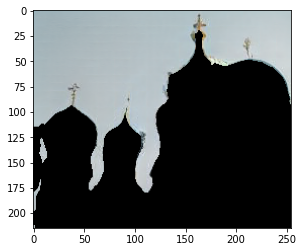

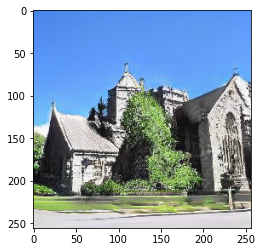

0 146 0 255


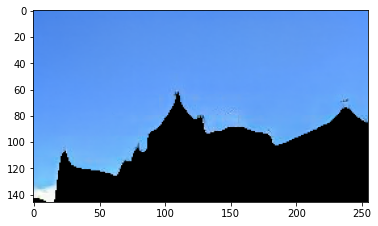

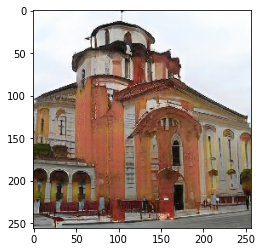

0 133 0 255


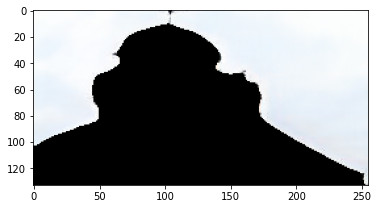

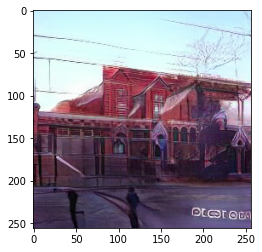

0 118 0 255


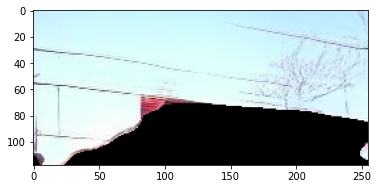

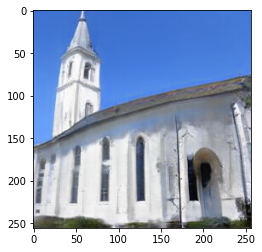

0 157 0 255


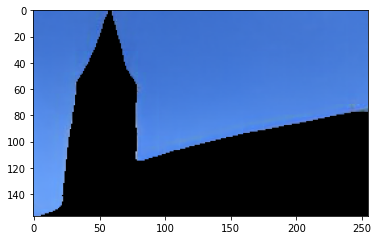

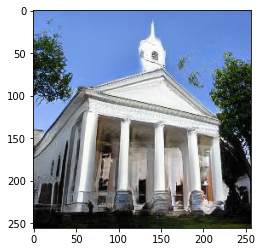

0 175 0 255


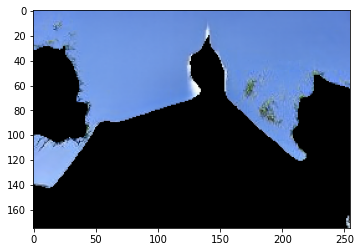

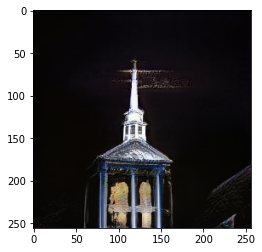

0 255 0 255


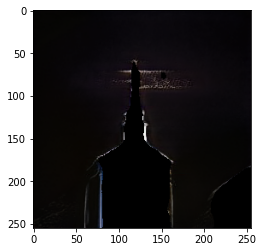

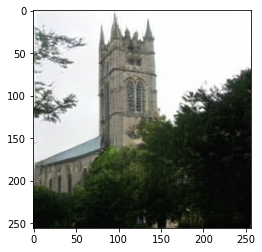

0 178 0 255


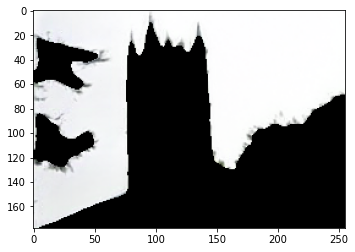

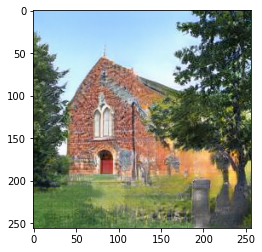

0 168 0 195


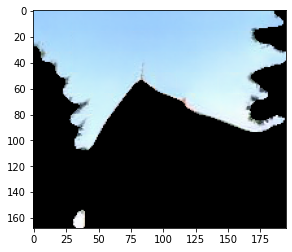

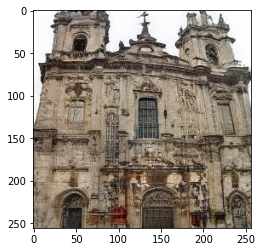

0 130 0 255


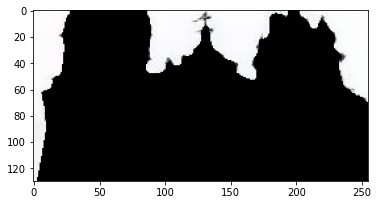

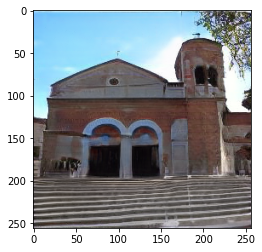

0 126 0 255


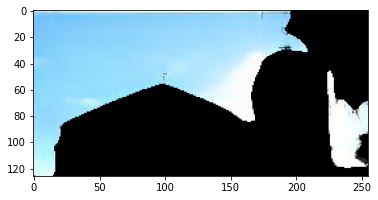

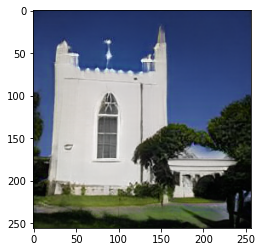

0 171 0 255


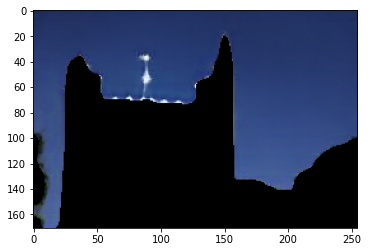

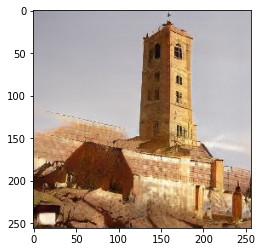

0 187 0 255


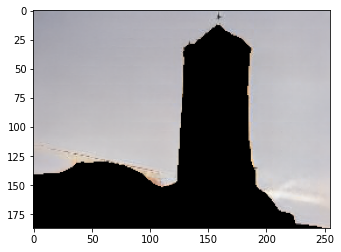

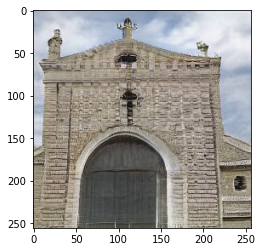

0 160 0 255


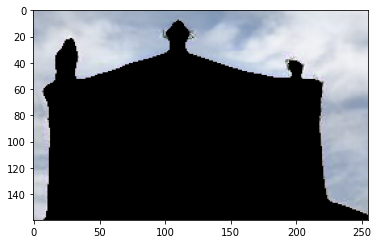

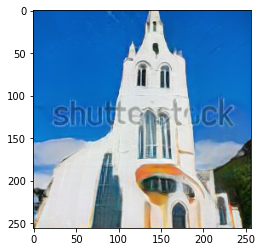

0 224 0 255


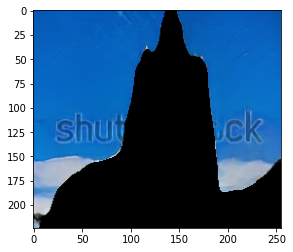

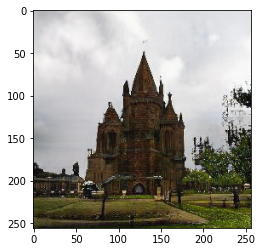

0 196 0 255


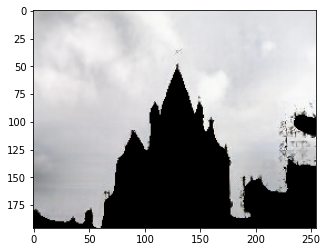

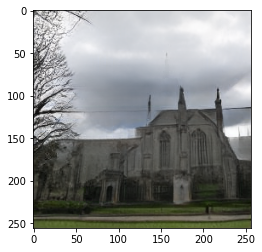

0 151 30 255


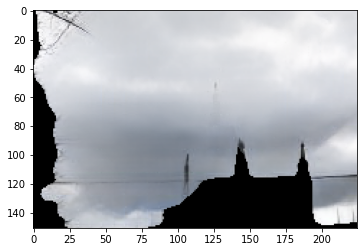

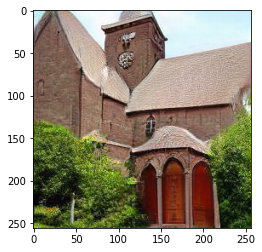

0 54 0 255


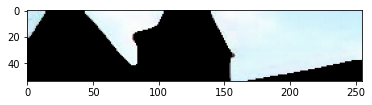

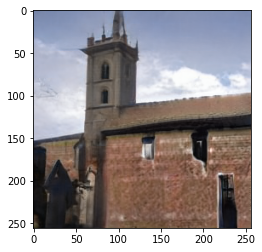

0 152 0 255


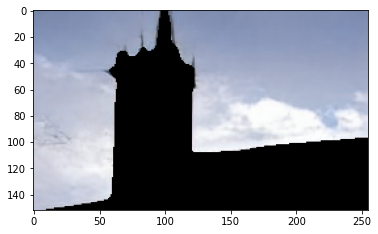

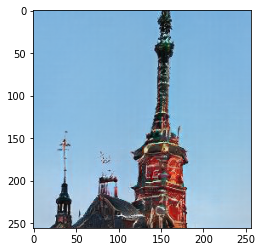

0 255 0 255


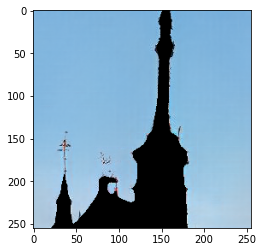

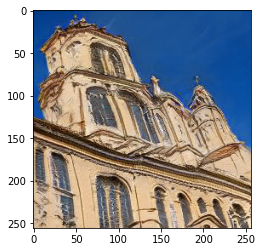

0 161 0 255


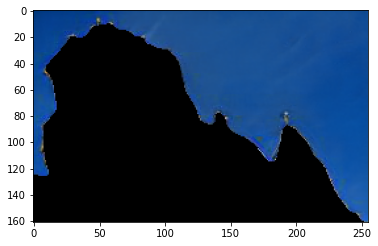

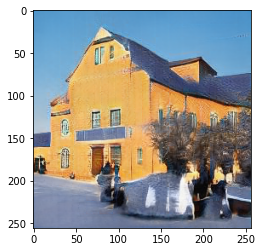

0 144 0 255


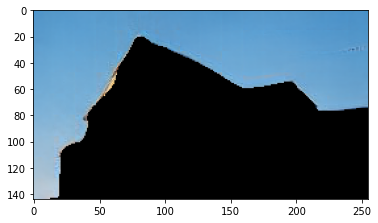

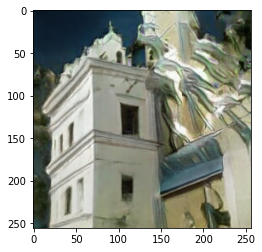

0 75 0 126


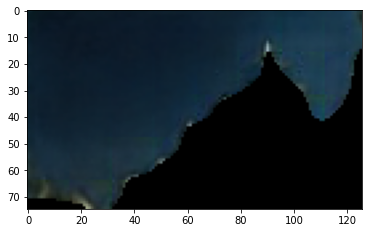

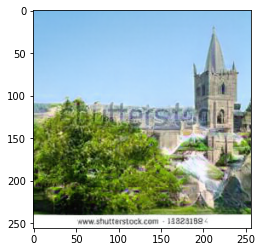

0 117 0 255


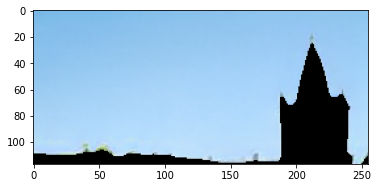

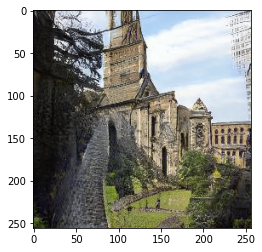

0 131 28 255


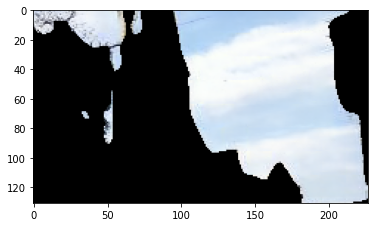

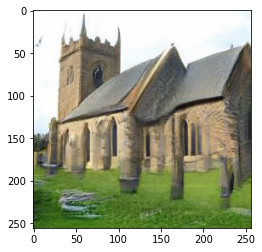

0 145 0 255


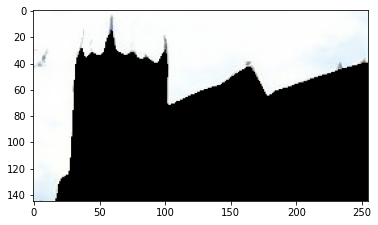

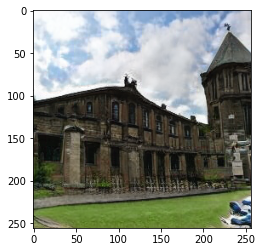

0 131 0 255


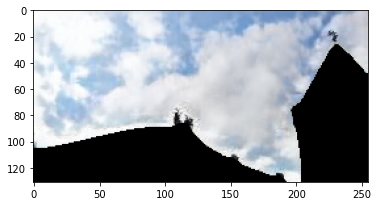

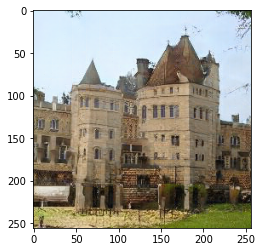

0 131 0 255


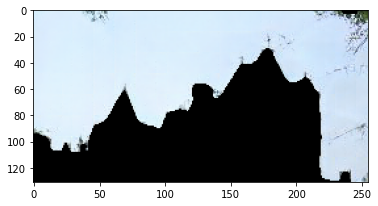

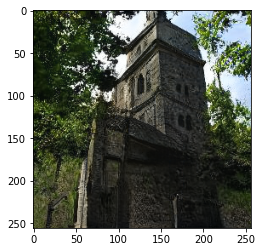

0 133 85 255


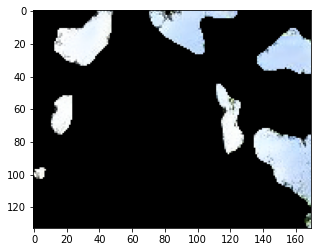

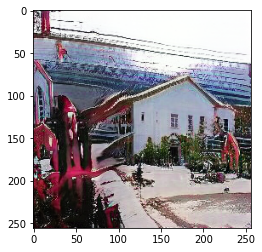

0 89 0 255


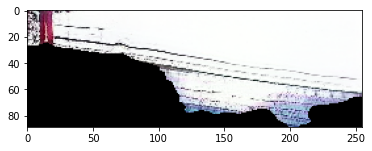

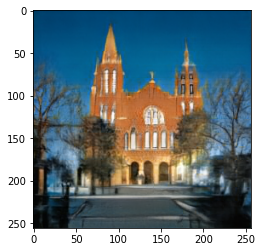

0 205 0 255


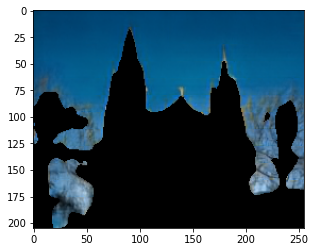

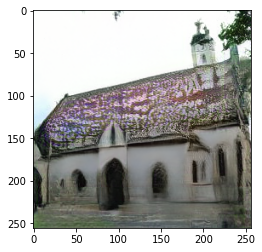

0 143 0 255


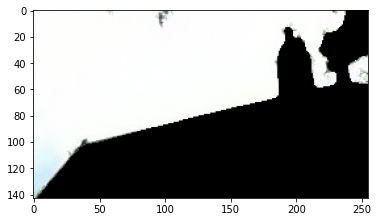

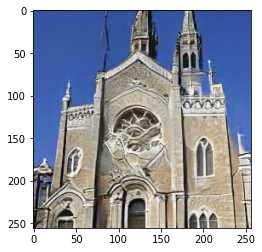

0 183 0 255


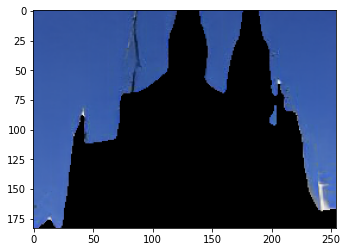

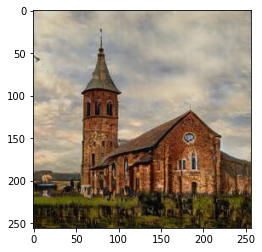

0 190 0 255


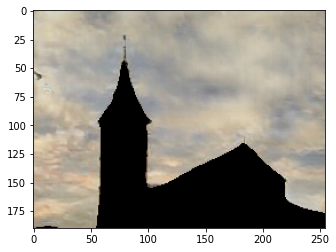

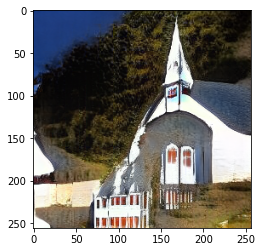

0 192 0 255


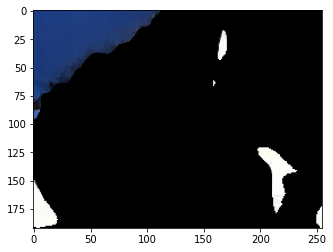

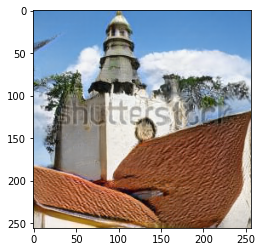

0 183 0 255


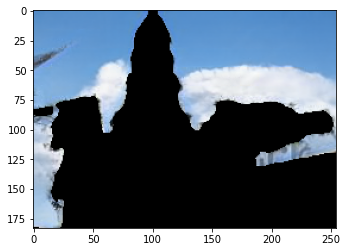

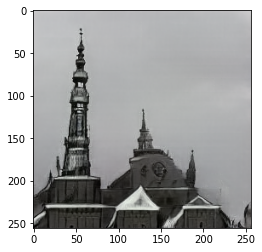

0 240 0 255


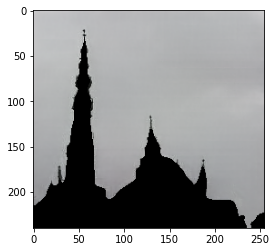

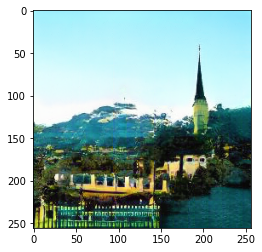

0 134 0 255


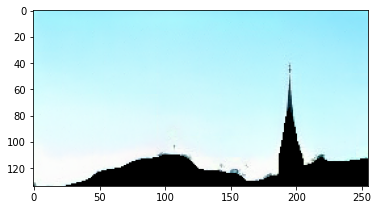

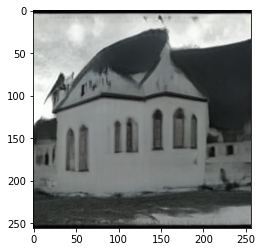

0 132 0 255


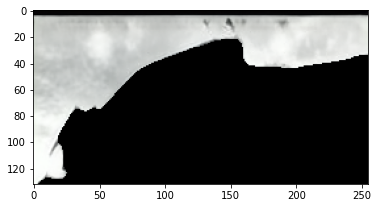

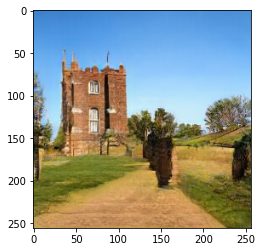

0 150 0 255


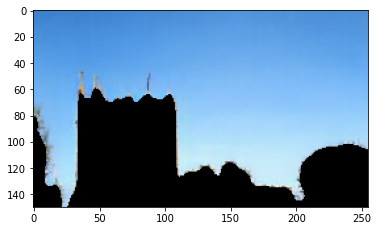

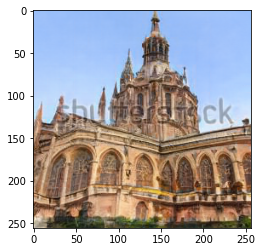

0 142 0 255


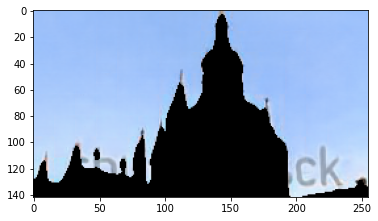

In [ ]:
for i in range(50):
  path = p_1[i]
  mask = m_1[i]
  im_1 = Image.open(path).resize((256, 256))

  ar_im_1 = np.array(im_1).transpose(2, 0, 1)
  y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(mask, label)
  if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
    continue
  if x_max_1 > x_min_1 and y_max_1 > y_min_1:
    plt.imshow(im_1)
    plt.show()
    print(y_min_1, y_max_1, x_min_1, x_max_1)
    bitmap = ((mask == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]
    plt.imshow(one_class_1.transpose(1, 2, 0))
    plt.show()
  

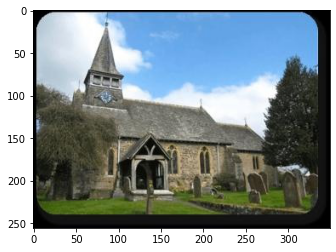

0 147 0 335


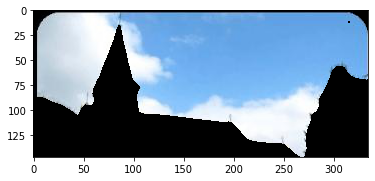

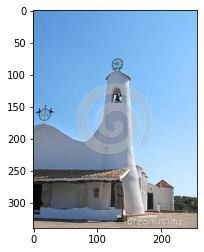

0 290 0 255


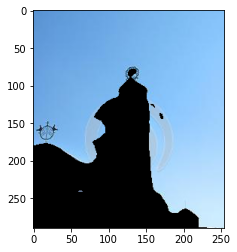

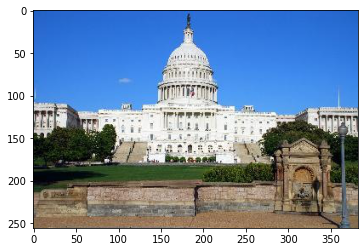

0 121 0 381


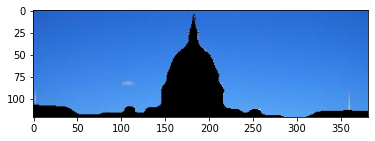

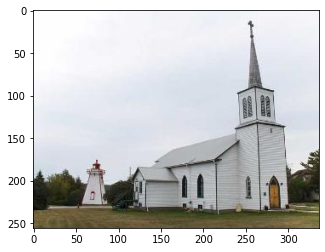

0 203 0 335


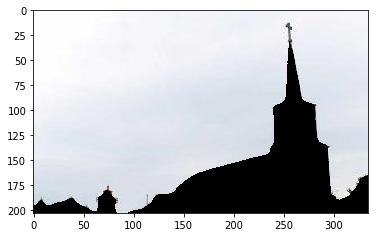

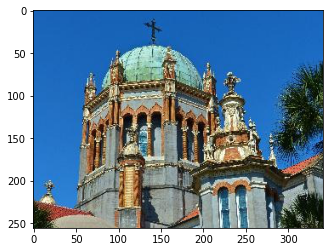

0 232 0 340


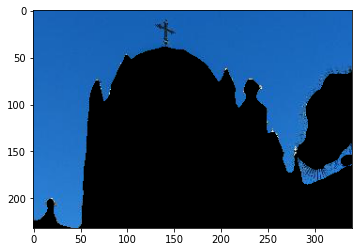

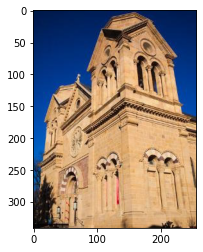

0 283 0 255


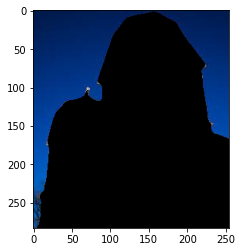

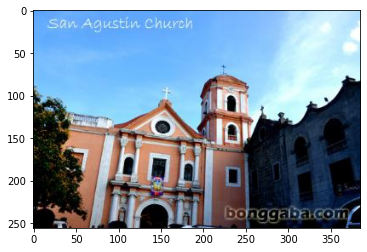

0 139 0 384


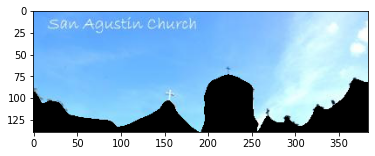

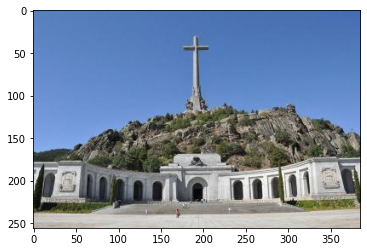

0 165 0 384


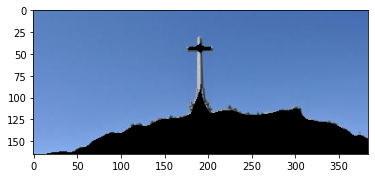

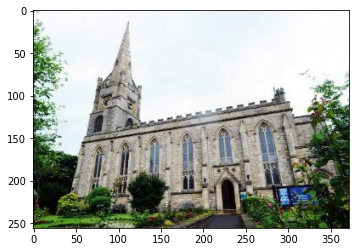

0 169 0 371


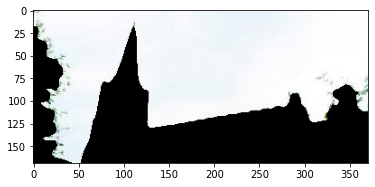

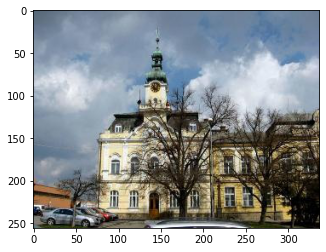

0 205 0 336


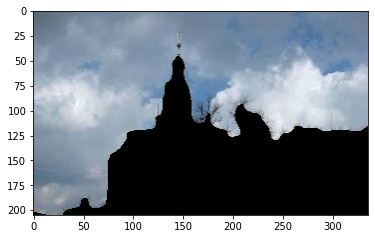

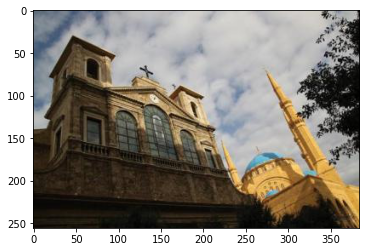

0 207 0 383


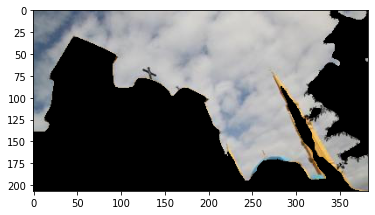

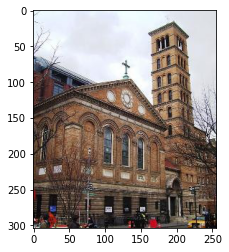

0 181 0 255


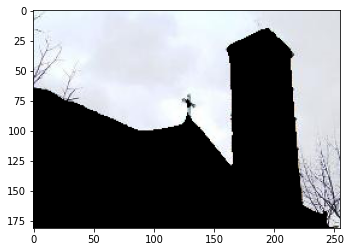

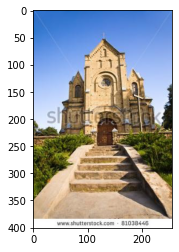

0 224 0 255


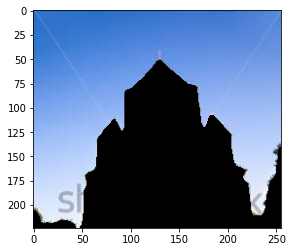

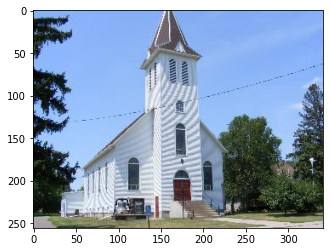

0 210 0 340


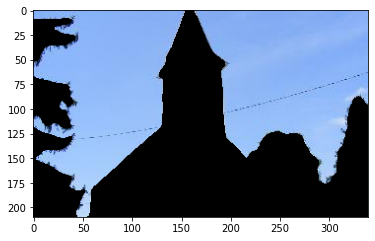

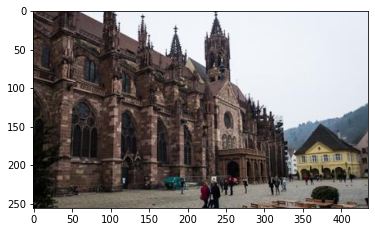

0 153 62 434


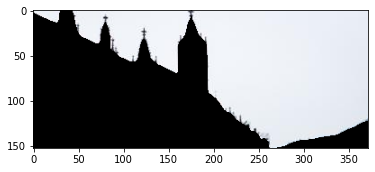

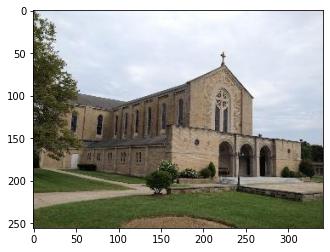

0 157 4 340


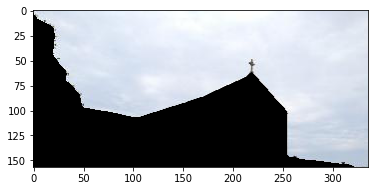

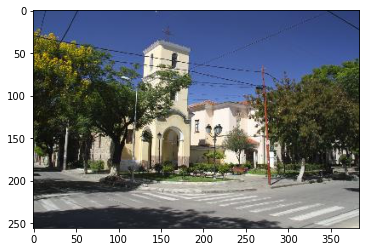

0 109 0 383


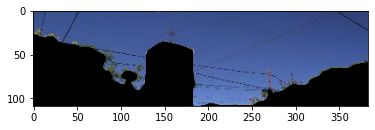

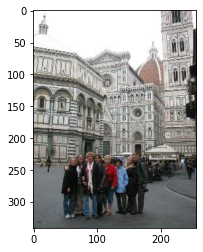

0 93 0 255


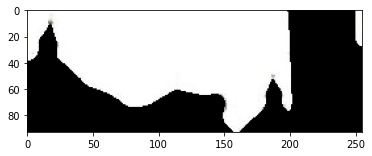

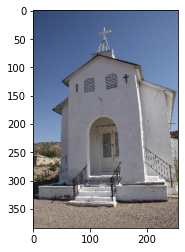

0 232 0 255


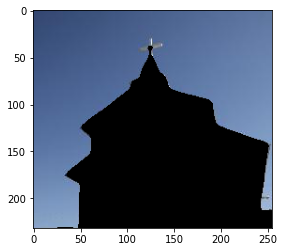

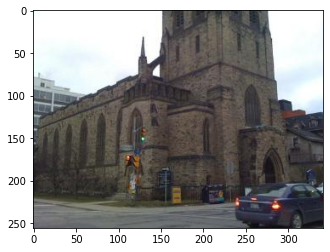

0 120 0 340


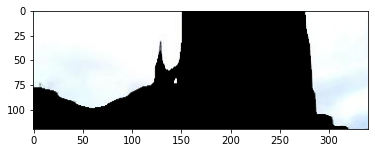

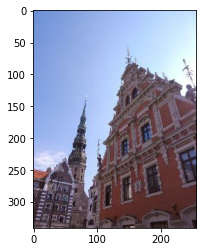

0 289 0 255


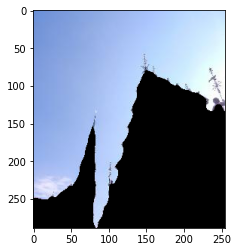

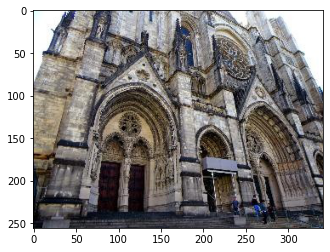

0 93 0 340


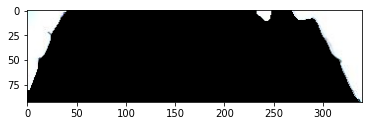

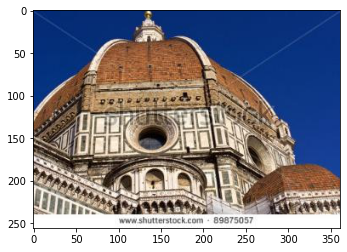

0 194 0 360


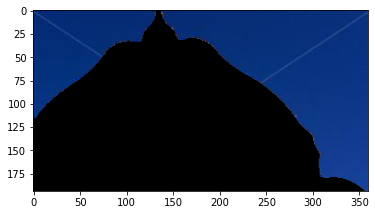

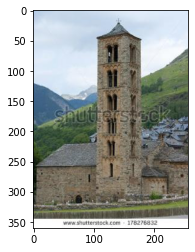

0 140 0 255


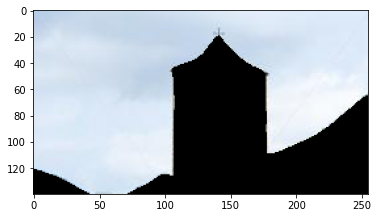

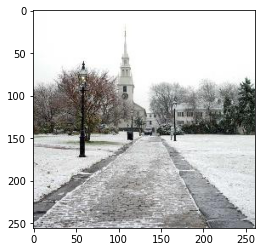

0 120 0 260


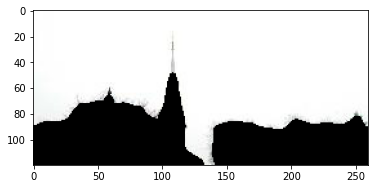

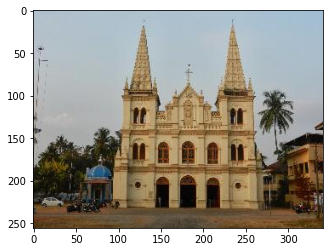

0 181 0 340


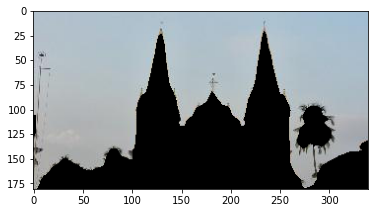

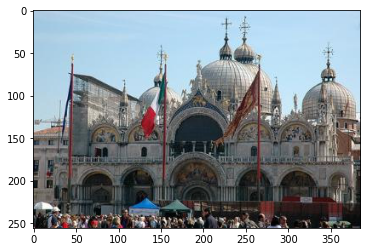

0 141 0 384


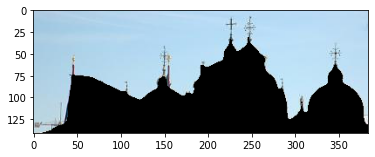

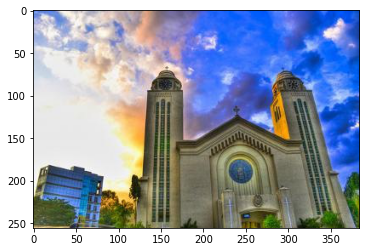

0 216 0 383


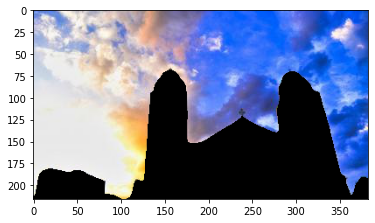

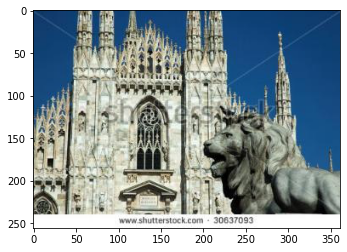

0 190 0 360


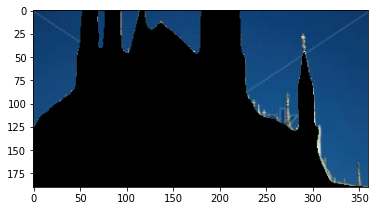

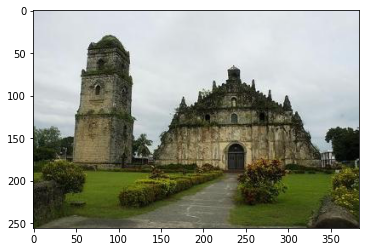

0 167 0 382


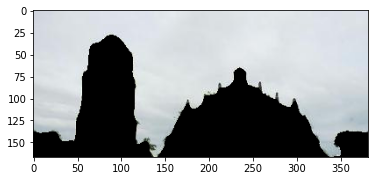

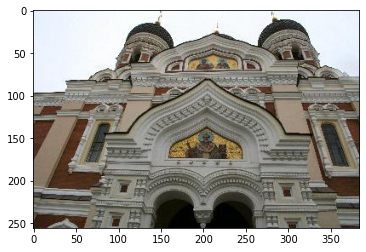

0 95 0 383


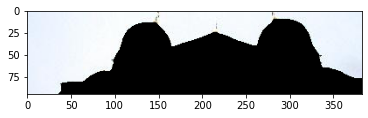

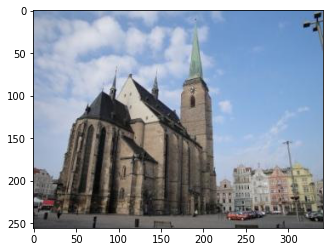

0 202 0 340


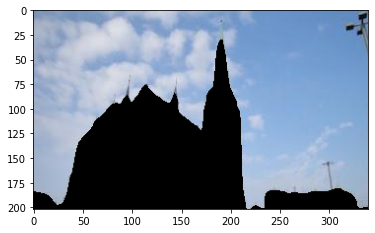

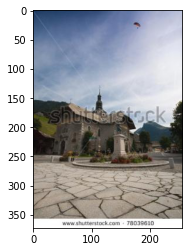

0 204 0 255


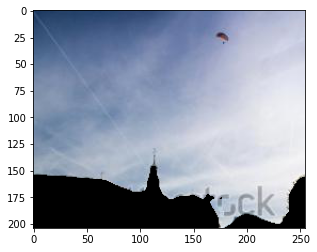

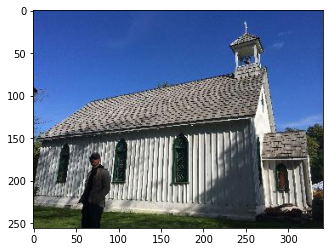

0 149 0 340


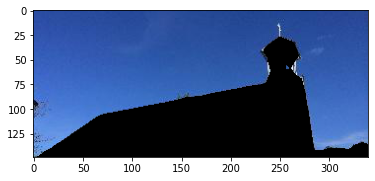

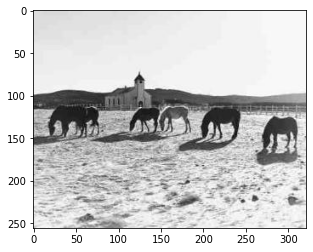

0 101 0 320


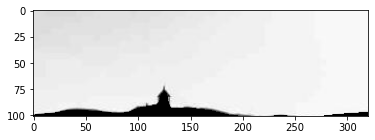

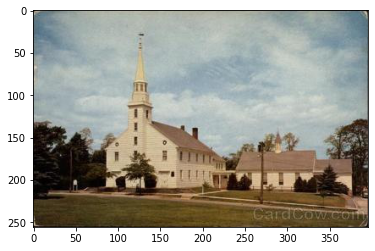

0 174 0 395


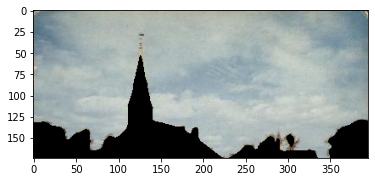

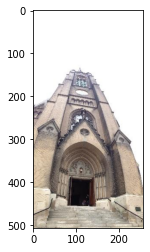

0 401 0 255


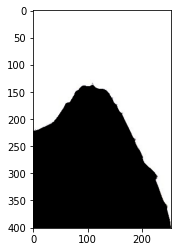

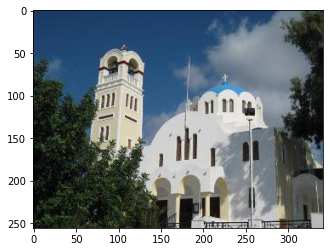

0 166 0 340


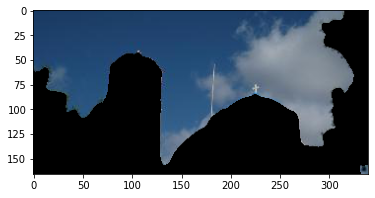

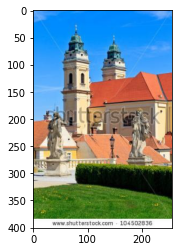

0 202 0 255


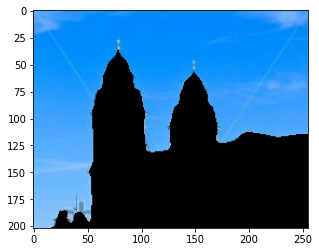

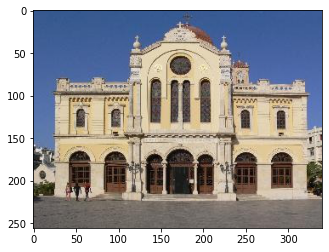

0 162 0 339


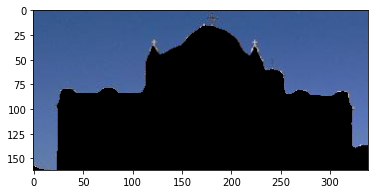

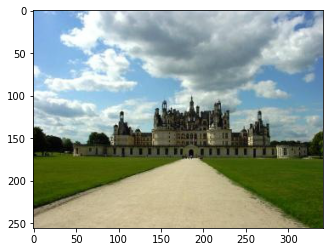

0 153 0 340


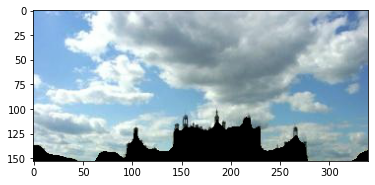

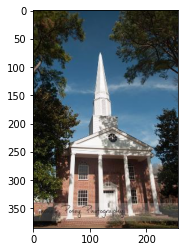

0 274 0 255


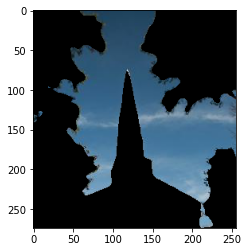

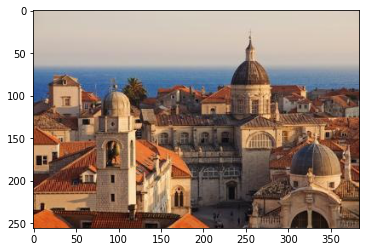

0 106 0 383


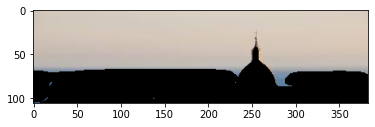

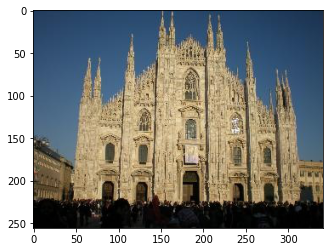

0 178 0 340


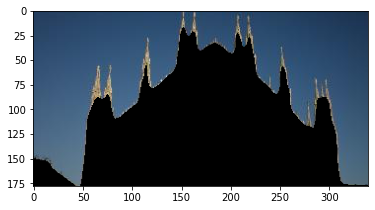

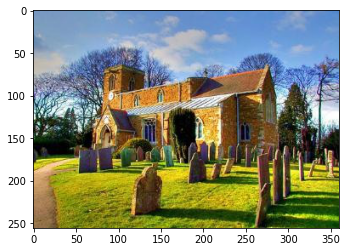

0 137 0 359


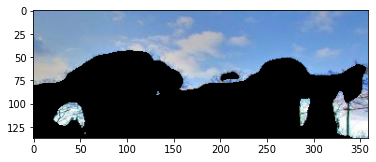

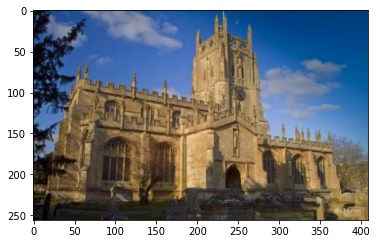

0 178 0 408


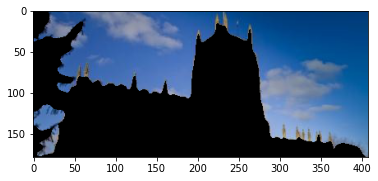

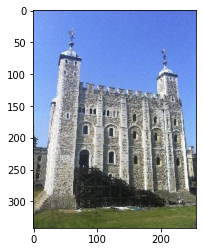

0 223 0 255


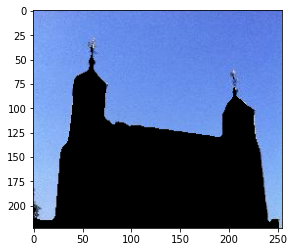

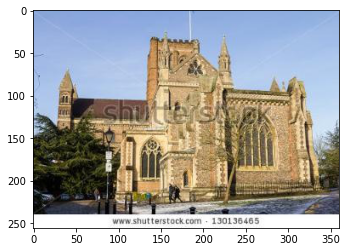

0 166 0 359


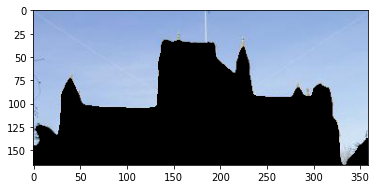

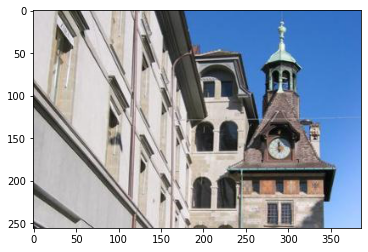

0 255 179 385


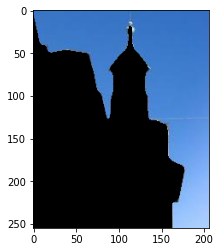

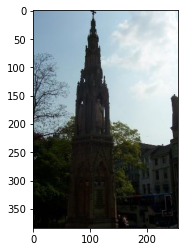

0 236 0 255


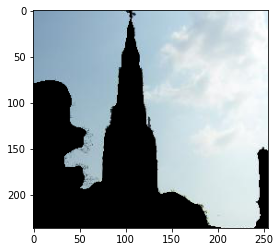

In [ ]:
for i in range(50):
  path = p_2[i]
  mask = m_2[i]
  im_1 = Image.open(path)
  ar_im_1 = np.array(im_1).transpose(2, 0, 1)
  y_min_1, y_max_1, x_min_1, x_max_1 = get_bounding_box(mask, label)
  if x_max_1 - x_min_1 < 32 or y_max_1 - y_min_1 < 32:
    continue
  if x_max_1 > x_min_1 and y_max_1 > y_min_1:
    plt.imshow(im_1)
    plt.show()
    print(y_min_1, y_max_1, x_min_1, x_max_1)
    bitmap = ((mask == label) > 0)
    one_class_1 = ar_im_1 * bitmap
    one_class_1 = one_class_1[:, y_min_1:y_max_1, x_min_1:x_max_1]
    plt.imshow(one_class_1.transpose(1, 2, 0))
    plt.show()
  